In [1]:
import numpy as np
import tensorflow as tf
import matplotlib.pyplot as plt
from skimage.transform import resize
from keras.utils.vis_utils import plot_model
import imageio
import glob

import os
from PIL import Image

In [2]:
!apt-get install unrar


Reading package lists... Done
Building dependency tree       
Reading state information... Done
The following NEW packages will be installed:
  unrar
0 upgraded, 1 newly installed, 0 to remove and 50 not upgraded.
Need to get 113 kB of archives.
After this operation, 406 kB of additional disk space will be used.
Get:1 http://archive.ubuntu.com/ubuntu focal/multiverse amd64 unrar amd64 1:5.6.6-2build1 [113 kB]
Fetched 113 kB in 1s (140 kB/s) 
debconf: unable to initialize frontend: Dialog
debconf: (No usable dialog-like program is installed, so the dialog based frontend cannot be used. at /usr/share/perl5/Debconf/FrontEnd/Dialog.pm line 76, <> line 1.)
debconf: falling back to frontend: Readline
Selecting previously unselected package unrar.
(Reading database ... 53268 files and directories currently installed.)
Preparing to unpack .../unrar_1%3a5.6.6-2build1_amd64.deb ...
Unpacking unrar (1:5.6.6-2build1) ...
Setting up unrar (1:5.6.6-2build1) ...
update-alternatives: using /usr/bin/un

In [8]:
!unrar x MRI+T1_T2+Dataset.RAR MRI_T1_T2/


UNRAR 5.61 beta 1 freeware      Copyright (c) 1993-2018 Alexander Roshal


Extracting from MRI+T1_T2+Dataset.RAR

Creating    MRI_T1_T2/Tr1                                             OK
Extracting  MRI_T1_T2/Tr1/.DS_Store                                      0  OK 
Creating    MRI_T1_T2/Tr1/TrainT1                                     OK
Extracting  MRI_T1_T2/Tr1/TrainT1/Image #10.png                          1  OK 
Extracting  MRI_T1_T2/Tr1/TrainT1/Image #11.png                          2  OK 
Extracting  MRI_T1_T2/Tr1/TrainT1/Image #12.png                          3  OK 
Extracting  MRI_T1_T2/Tr1/TrainT1/Image #13.png                          4  OK 
Extracting  MRI_T1_T2/Tr1/TrainT1/Image #14.png                          5  OK 
Extracting  MRI_T1_T2/Tr1/TrainT1/Image #15.png                          6  OK 
Extracting  MRI_T1_T2/Tr1/TrainT1/Image #16.png                          7  OK 
Extracting  MRI_T1_T2/Tr1/TrainT1/Image #17.png                          8  OK 
Extracting  MRI_T1_

In [2]:
def LoadImagesFromPath(path):
    # Directory containing the images
    image_dir = path
    
    # Load images into a list
    images = []
    
    for filename in os.listdir(image_dir):
        if filename.endswith('.png'):
            img_path = os.path.join(image_dir, filename)
            img = Image.open(img_path).convert('L')  # Convert image to grayscale
            #img = img.resize((28, 28))  # Resize image if needed
            img_array = np.array(img)
            images.append(img_array)

    # Convert list to a NumPy array
    train_images = np.array(images)
    
    train_images = (train_images/127.5)-1.0 # Normalize the images to [-1.0, 1.0]
    
    return train_images

In [3]:
Tr1_train_images = LoadImagesFromPath('MRI_T1_T2/Tr1/TrainT1/')

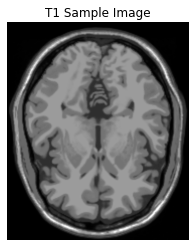

In [4]:

# Visualize the first image in the array
plt.imshow(Tr1_train_images[0], cmap='gray')
plt.title('T1 Sample Image')
plt.axis('off')  # Hide axes for a cleaner look
plt.show()

In [5]:
Tr2_train_images = LoadImagesFromPath('MRI_T1_T2/Tr2/TrainT2/')

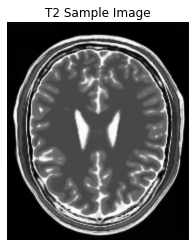

In [6]:
# Visualize the first image in the array
plt.imshow(Tr2_train_images[0], cmap='gray')
plt.title('T2 Sample Image')
plt.axis('off')  # Hide axes for a cleaner look
plt.show()

In [7]:
Tr1_train_images.shape

(43, 217, 181)

In [8]:
Tr2_train_images.shape

(46, 217, 181)

In [38]:
BATCH_SIZE = 1024

# As we can see we have 43 images for T1 type and 46 images for T2 type

## Also we can see the all images are of size 217 , 181

## Let's resize these images to 128 , 128

In [9]:
Tr1_data = np.zeros((Tr1_train_images.shape[0], 128, 128))
for index, img in enumerate(Tr1_train_images):
    Tr1_data[index, :, :] = resize(img, (128, 128))
Tr1_data.shape

(43, 128, 128)

In [10]:
Tr2_data = np.zeros((Tr2_train_images.shape[0], 128, 128))
for index, img in enumerate(Tr2_train_images):
    Tr2_data[index, :, :] = resize(img, (128, 128))
Tr2_data.shape

(46, 128, 128)

#### Reshape Images to (128, 128, 1) with float pixel values

In [11]:
Tr1_data = Tr1_data.reshape(Tr1_data.shape[0], 128, 128, 1).astype('float32')
Tr2_data = Tr2_data.reshape(Tr2_data.shape[0], 128, 128, 1).astype('float32')

#### Batch and shuffle the data

In [39]:
Tr1_data = tf.data.Dataset.from_tensor_slices(Tr1_data).shuffle(Tr1_train_images.shape[0], seed=42).batch(BATCH_SIZE)
Tr2_data = tf.data.Dataset.from_tensor_slices(Tr2_data).shuffle(Tr2_train_images.shape[0], seed=42).batch(BATCH_SIZE)

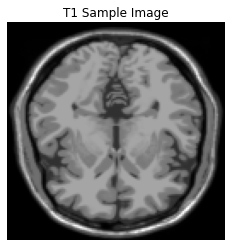

In [12]:
# Visualize the first image in the array
plt.imshow(Tr1_data[0], cmap='gray')
plt.title('T1 Sample Image')
plt.axis('off')  # Hide axes for a cleaner look
plt.show()

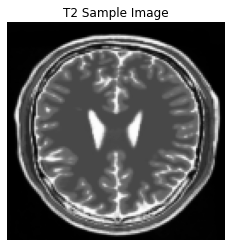

In [13]:
# Visualize the first image in the array
plt.imshow(Tr2_data[0], cmap='gray')
plt.title('T2 Sample Image')
plt.axis('off')  # Hide axes for a cleaner look
plt.show()

### Model Building
1. Instance Normalization
2. Downsampling, Upsampling and Unet
3. Generator Building using Unet
4. Discriminator Building

#### Instance Normalization

In [14]:
class InstanceNormalization(tf.keras.layers.Layer):
    # Initialization of Objects
    def __init__(self, epsilon=1e-5):
        # calling parent's init
        super(InstanceNormalization, self).__init__()
        self.epsilon = epsilon
    
    def build(self, input_shape):
        self.scale = self.add_weight(
            name='scale',
            shape=input_shape[-1:],
            initializer=tf.random_normal_initializer(1., 0.02),
            trainable=True)
        self.offset = self.add_weight(
            name='offset',
            shape=input_shape[-1:],
            initializer='zeros',
            trainable=True)
    
    def call(self, x):
        # Compute Mean and Variance, Axes=[1,2] ensures Instance Normalization
        mean, variance = tf.nn.moments(x, axes=[1, 2], keepdims=True)
        inv = tf.math.rsqrt(variance + self.epsilon)
        normalized = (x - mean) * inv
        return self.scale * normalized + self.offset

#### Downsampling
Downsampling is performed using the Convolution, leading to reduce in dimensions.

In [15]:
def downsample(filters, size, apply_norm=True):
    initializer = tf.random_normal_initializer(0., 0.02)
    result = tf.keras.Sequential()
    # Add Conv2d layer
    result.add(tf.keras.layers.Conv2D(filters, size, strides=2, padding='same',
                                      kernel_initializer=initializer, use_bias=False))
    # Add Normalization layer
    if apply_norm:
        result.add(InstanceNormalization())
    # Add Leaky Relu Activation
    result.add(tf.keras.layers.LeakyReLU())
    return result

#### Upsampling
Upsampling is a result of Transposed Convolution, where dimension of image are increased.

In [16]:
def upsample(filters, size, apply_dropout=False):
    initializer = tf.random_normal_initializer(0., 0.02)
    result = tf.keras.Sequential()
    # Add Transposed Conv2d layer
    result.add(tf.keras.layers.Conv2DTranspose(filters, size, strides=2, padding='same',
                                               kernel_initializer=initializer, use_bias=False))
    # Add Normalization Layer
    result.add(InstanceNormalization())
    # Conditionally add Dropout layer
    if apply_dropout:
        result.add(tf.keras.layers.Dropout(0.5))
    # Add Relu Activation Layer
    result.add(tf.keras.layers.ReLU())
    return result

#### Unets
Unets takes Image as an input and translate it into another Image. <p>
To do this they first use Downsampling on Input Image to learn the latent characteristics of Input Image and then use Upsampling to use this knowledge to Translate it into another Image. <p>

In [28]:
# Unet Generator is a combination of Convolution + Transposed Convolution Layers
def unet_generator():
    down_stack = [
        downsample(64, 4, False),  # (bs, 64, 64, 64)
        downsample(128, 4),        # (bs, 32, 32, 128)
        downsample(256, 4),        # (bs, 16, 16, 256)
        downsample(512, 4),        # (bs, 8, 8, 512)
        downsample(512, 4),        # (bs, 4, 4, 512)
        downsample(512, 4),        # (bs, 2, 2, 512)
        downsample(512, 4)         # (bs, 1, 1, 512)
    ]
    up_stack = [
        upsample(512, 4, True),    # (bs, 2, 2, 1024)
        upsample(512, 4, True),    # (bs, 4, 4, 1024)
        upsample(512, 4),          # (bs, 8, 8, 1024)
        upsample(256, 4),          # (bs, 16, 16, 512)
        upsample(128, 4),          # (bs, 32, 32, 256)
        upsample(64, 4),           # (bs, 64, 64, 128)
    ]
    initializer = tf.random_normal_initializer(0., 0.02)
    last = tf.keras.layers.Conv2DTranspose(1, 4, strides=2, padding='same', kernel_initializer=initializer,
                                           activation='tanh')  # (bs, 128, 128, 1)
    concat = tf.keras.layers.Concatenate()
    inputs = tf.keras.layers.Input(shape=[128, 128, 1])
    x = inputs
    # Downsampling through the model
    skips = []
    for down in down_stack:
        x = down(x)
        skips.append(x)
    
    skips = reversed(skips[:-1])
    # Upsampling and establishing the skip connections
    for up, skip in zip(up_stack, skips):
        x = up(x)
        x = concat([x, skip])
    x = last(x)
    return tf.keras.Model(inputs=inputs, outputs=x)

#### Generator
Generator is a Unet Network here since We want to translate One type of Image (T1) into Another type of Image (T2).

In [29]:
generator_g = unet_generator()
generator_f = unet_generator()

Let's also visualize one of our Generator Models since Both our Generators have same architecture.

Notice How the dimension reduces first but then increases.

In [30]:
generator_g.summary()

Model: "model_4"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_3 (InputLayer)           [(None, 128, 128, 1  0           []                               
                                )]                                                                
                                                                                                  
 sequential_34 (Sequential)     (None, 64, 64, 64)   1024        ['input_3[0][0]']                
                                                                                                  
 sequential_35 (Sequential)     (None, 32, 32, 128)  131328      ['sequential_34[0][0]']          
                                                                                                  
 sequential_36 (Sequential)     (None, 16, 16, 256)  524800      ['sequential_35[0][0]']    

#### Discriminator
Discriminator is a traditional CNN, which we use to classify the Images. It only uses Downsampling hence.

Both Discriminators have same architecture

In [31]:
# Discriminators only contain Convolutional Layers and no Transposed Convolution is not used 
def discriminator():
    initializer = tf.random_normal_initializer(0., 0.02)
    
    # Modify input layer for size (128, 128, 1)
    inp = tf.keras.layers.Input(shape=[128, 128, 1], name='input_image')
    x = inp
    
    # Downsampling layers
    down1 = downsample(64, 4, False)(x)  # (bs, 64, 64, 64)
    down2 = downsample(128, 4)(down1)    # (bs, 32, 32, 128)
    down3 = downsample(256, 4)(down2)    # (bs, 16, 16, 256)
    down4 = downsample(512, 4)(down3)    # (bs, 8, 8, 512)
    
    # Add a padding layer here
    zero_pad1 = tf.keras.layers.ZeroPadding2D()(down4)  # (bs, 10, 10, 512)
    
    # Convolution layer with strides=1
    conv = tf.keras.layers.Conv2D(512, 4, strides=1, kernel_initializer=initializer,
                                  use_bias=False)(zero_pad1)  # (bs, 7, 7, 512)
    norm1 = InstanceNormalization()(conv)
    leaky_relu = tf.keras.layers.LeakyReLU()(norm1)
    
    # Apply another padding layer
    zero_pad2 = tf.keras.layers.ZeroPadding2D()(leaky_relu)  # (bs, 9, 9, 512)
    
    # Final Convolution layer to get a single output per patch
    last = tf.keras.layers.Conv2D(1, 4, strides=1, kernel_initializer=initializer)(zero_pad2)  # (bs, 6, 6, 1)
    
    return tf.keras.Model(inputs=inp, outputs=last)

In [32]:
discriminator_x = discriminator()
discriminator_y = discriminator()

In [33]:
discriminator_x.summary()

Model: "model_6"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_image (InputLayer)    [(None, 128, 128, 1)]     0         
                                                                 
 sequential_60 (Sequential)  (None, 64, 64, 64)        1024      
                                                                 
 sequential_61 (Sequential)  (None, 32, 32, 128)       131328    
                                                                 
 sequential_62 (Sequential)  (None, 16, 16, 256)       524800    
                                                                 
 sequential_63 (Sequential)  (None, 8, 8, 512)         2098176   
                                                                 
 zero_padding2d_4 (ZeroPaddi  (None, 10, 10, 512)      0         
 ng2D)                                                           
                                                           

### Model Training
1. Declare Loss type
2. Calculate Discriminator Loss
3. Calculate Generator Loss
4. Cycle Loss
5. Identity Loss
6. Optimizer
7. Checkpoint Initialization
8. Training Flow

Check output of Untrained Generator models which should be a random noise

In [40]:
sample_T1_data = next(iter(Tr1_data))
sample_T2_data = next(iter(Tr2_data))

In [41]:
sample_T1_data.shape

TensorShape([43, 128, 128, 1])

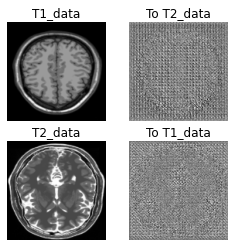

In [43]:
to_T2_data = generator_g(sample_T1_data)
to_T1_data = generator_f(sample_T2_data)
plt.figure(figsize=(4, 4))

imgs = [sample_T1_data, to_T2_data, sample_T2_data, to_T1_data]
title = ['T1_data', 'To T2_data', 'T2_data', 'To T1_data']

for i in range(len(imgs)):
    plt.subplot(2, 2, i+1)
    plt.title(title[i])
    plt.imshow(imgs[i][0].numpy()[:, :, 0], cmap='gray')
    plt.axis('off')
plt.show()

#### Declare Loss as Binary Cross Entropy
Since Our Discriminator is a classifier

In [44]:
loss_obj = tf.keras.losses.BinaryCrossentropy(from_logits=True)

#### Discriminator Loss
It consists of two types of losses
1.    Loss on Real Data
2.    Loss on Fake Data

In [46]:
def discriminator_loss(real, generated):
    real_loss = loss_obj(tf.ones_like(real), real)
    generated_loss = loss_obj(tf.zeros_like(generated), generated)
    total_disc_loss = real_loss + generated_loss
    return total_disc_loss * 0.5 # mean of losses

#### Generator Loss
It has only one type of loss - Discriminator Loss on Generated data

In [47]:
def generator_loss(generated):
    return loss_obj(tf.ones_like(generated), generated)

#### Cycle Loss
When we use both of Generators sequentially on a Input Image, we get Cycle Image and the L1 Loss between these two is called Cycle Loss.

In [48]:
def calc_cycle_loss(real_image, cycled_image):
    loss1 = tf.reduce_mean(tf.abs(real_image - cycled_image))
    return 10.0 * loss1

#### Identity Loss
When we provide input image to the Generator such that no translation is needed because the Image is already transformed. Here also we take L1 Loss between Input and Output Image.

In [49]:
def identity_loss(real_image, same_image):
    loss = tf.reduce_mean(tf.abs(real_image - same_image))
    return 0.5*loss

#### Optimizer 
We use Adam Optimizer to update weights which is a good optimizer to achieve quick learning.

In [51]:
generator_g_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)
generator_f_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)

discriminator_x_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)
discriminator_y_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)

We'll train out Model for 100 Epochs

In [60]:
EPOCHS = 300

#### Checkpoint Initialization
Initialize checkpoints to save models

In [54]:
checkpoint_path = "./Trained_Model"

ckpt = tf.train.Checkpoint(generator_g=generator_g,
                           generator_f=generator_f,
                           discriminator_x=discriminator_x,
                           discriminator_y=discriminator_y,
                           generator_g_optimizer=generator_g_optimizer,
                           generator_f_optimizer=generator_f_optimizer,
                           discriminator_x_optimizer=discriminator_x_optimizer,
                           discriminator_y_optimizer=discriminator_y_optimizer)

ckpt_manager = tf.train.CheckpointManager(ckpt, checkpoint_path, max_to_keep=3)

# if a checkpoint exists, restore the latest checkpoint.
if ckpt_manager.latest_checkpoint:
    ckpt.restore(ckpt_manager.latest_checkpoint)
    print ('Latest checkpoint restored!!')

Function to show Images output by Generators while Training

In [55]:
def generate_images(model1, test_input1, model2, test_input2):
    prediction1 = model1(test_input1)
    prediction2 = model2(test_input2)
    plt.figure(figsize=(8, 4))
    display_list = [test_input1[0], prediction1[0], test_input2[0], prediction2[0]]
    title = ['Input Image', 'Predicted Image', 'Input Image', 'Predicted Image']
    for i in range(4):
        plt.subplot(1, 4, i+1)
        plt.title(title[i])
        plt.imshow(display_list[i].numpy()[:, :, 0], cmap='gray')
        plt.axis('off')

    plt.savefig('image_at_epoch_{:04d}.png'.format(epoch))
    plt.show()

#### Training FLow
Below Function performs one Flow of Batch Training <p>
Notice that Identity Loss and Cycle Loss are only used in training Generator and not Discriminator

Sequence of Training Flow


1.   Generate Fake Y and Cycled X
2.   Generate Fake X and Cycled Y
3.   Generate Fake Images through G and F for Identity Loss.
4.   Calculate Discriminator Loss for Disc X and Disc Y on Fake Data for Generator Training.
5.   Calculate Generator Loss on Discriminator.
6.   Calculate Cycled Loss on Cycled Images from step 1 and 2.
7.   Calculate Total Generator Loss - Disc Loss + Cycled Loss + Identity Loss
8.   Calculate Discriminator Loss on both Fake and Real Images for Disc X and Y for Disc Training.
9.   Calculate the Gradients and update the weight and bias of models.



In [56]:
@tf.function
def train_step(real_x, real_y):
    # persistent is set to True because the tape is used more than
    # once to calculate the gradients.
    with tf.GradientTape(persistent=True) as tape:
        # Generator G translates X -> Y
        # Generator F translates Y -> X
        fake_y = generator_g(real_x, training=True)
        cycled_x = generator_f(fake_y, training=True)
        
        fake_x = generator_f(real_y, training=True)
        cycled_y = generator_g(fake_x, training=True)
        
        # same_x and same_y are used for identity loss.
        same_x = generator_f(real_x, training=True)
        same_y = generator_g(real_y, training=True)
        
        disc_real_x = discriminator_x(real_x, training=True)
        disc_real_y = discriminator_y(real_y, training=True)
        
        disc_fake_x = discriminator_x(fake_x, training=True)
        disc_fake_y = discriminator_y(fake_y, training=True)
        
        # calculate the loss
        gen_g_loss = generator_loss(disc_fake_y)
        gen_f_loss = generator_loss(disc_fake_x)
        
        total_cycle_loss = calc_cycle_loss(real_x, cycled_x) + calc_cycle_loss(real_y, cycled_y)
        
        # Total generator loss = BCE loss + cycle loss + identity loss
        total_gen_g_loss = gen_g_loss + total_cycle_loss + identity_loss(real_y, same_y)
        total_gen_f_loss = gen_f_loss + total_cycle_loss + identity_loss(real_x, same_x)
        
        # Discriminator's loss
        disc_x_loss = discriminator_loss(disc_real_x, disc_fake_x)
        disc_y_loss = discriminator_loss(disc_real_y, disc_fake_y)
        
    # Calculate the gradients for generator and discriminator
    generator_g_gradients = tape.gradient(total_gen_g_loss, generator_g.trainable_variables)
    generator_f_gradients = tape.gradient(total_gen_f_loss, generator_f.trainable_variables)
    
    discriminator_x_gradients = tape.gradient(disc_x_loss, discriminator_x.trainable_variables)
    discriminator_y_gradients = tape.gradient(disc_y_loss, discriminator_y.trainable_variables)
    
    # Apply the gradients to the optimizer
    generator_g_optimizer.apply_gradients(zip(generator_g_gradients, generator_g.trainable_variables))
    generator_f_optimizer.apply_gradients(zip(generator_f_gradients, generator_f.trainable_variables))
    
    discriminator_x_optimizer.apply_gradients(zip(discriminator_x_gradients, discriminator_x.trainable_variables))
    discriminator_y_optimizer.apply_gradients(zip(discriminator_y_gradients, discriminator_y.trainable_variables))

#### Train the CycleGAN Model for several Epochs
Loop training function for number of epochs and also show the output at each step. <p>
Note how Generators are getting better at producing realistic images epoch by epoch

In [57]:
sample_T1_data.shape

TensorShape([43, 128, 128, 1])

In [58]:
sample_T2_data.shape

TensorShape([46, 128, 128, 1])

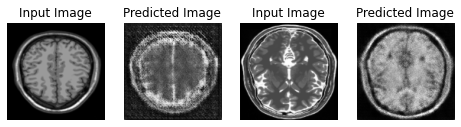

Saving checkpoint for epoch 1 at ./Trained_Model/ckpt-101


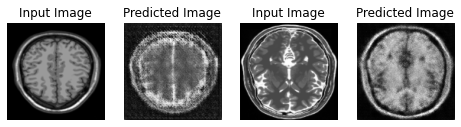

Saving checkpoint for epoch 2 at ./Trained_Model/ckpt-102


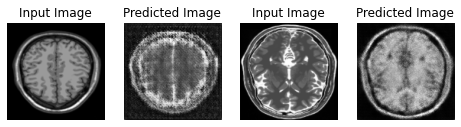

Saving checkpoint for epoch 3 at ./Trained_Model/ckpt-103


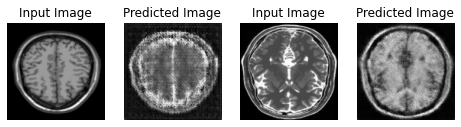

Saving checkpoint for epoch 4 at ./Trained_Model/ckpt-104


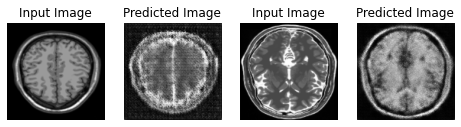

Saving checkpoint for epoch 5 at ./Trained_Model/ckpt-105


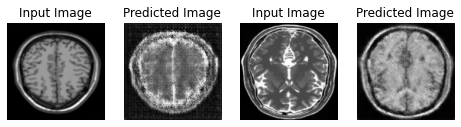

Saving checkpoint for epoch 6 at ./Trained_Model/ckpt-106


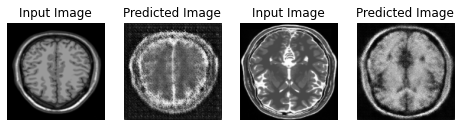

Saving checkpoint for epoch 7 at ./Trained_Model/ckpt-107


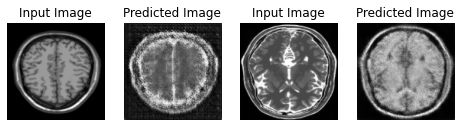

Saving checkpoint for epoch 8 at ./Trained_Model/ckpt-108


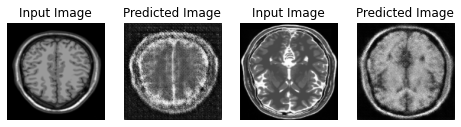

Saving checkpoint for epoch 9 at ./Trained_Model/ckpt-109


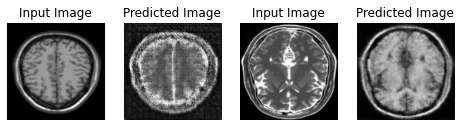

Saving checkpoint for epoch 10 at ./Trained_Model/ckpt-110


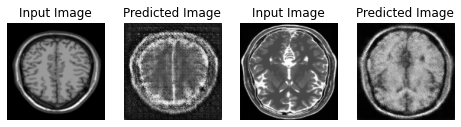

Saving checkpoint for epoch 11 at ./Trained_Model/ckpt-111


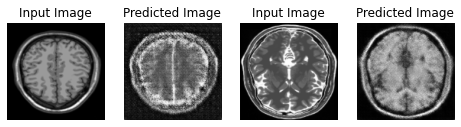

Saving checkpoint for epoch 12 at ./Trained_Model/ckpt-112


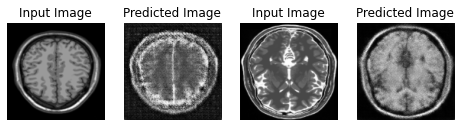

Saving checkpoint for epoch 13 at ./Trained_Model/ckpt-113


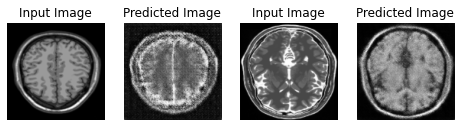

Saving checkpoint for epoch 14 at ./Trained_Model/ckpt-114


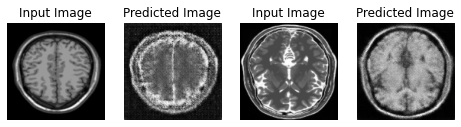

Saving checkpoint for epoch 15 at ./Trained_Model/ckpt-115


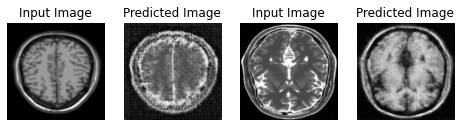

Saving checkpoint for epoch 16 at ./Trained_Model/ckpt-116


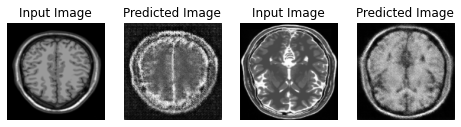

Saving checkpoint for epoch 17 at ./Trained_Model/ckpt-117


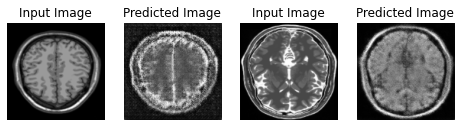

Saving checkpoint for epoch 18 at ./Trained_Model/ckpt-118


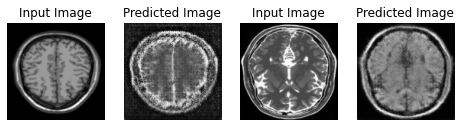

Saving checkpoint for epoch 19 at ./Trained_Model/ckpt-119


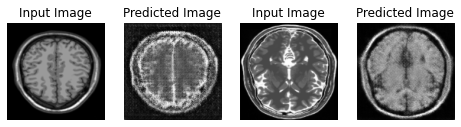

Saving checkpoint for epoch 20 at ./Trained_Model/ckpt-120


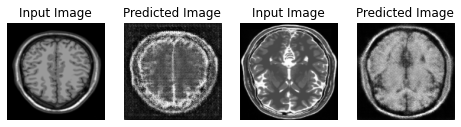

Saving checkpoint for epoch 21 at ./Trained_Model/ckpt-121


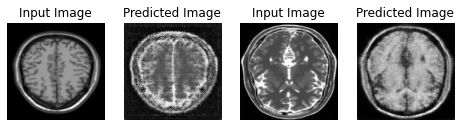

Saving checkpoint for epoch 22 at ./Trained_Model/ckpt-122


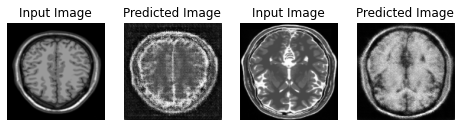

Saving checkpoint for epoch 23 at ./Trained_Model/ckpt-123


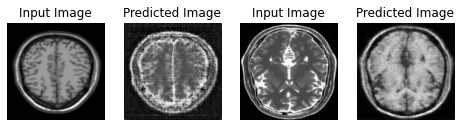

Saving checkpoint for epoch 24 at ./Trained_Model/ckpt-124


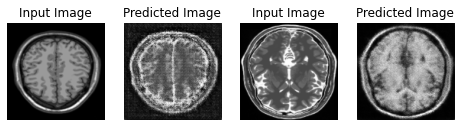

Saving checkpoint for epoch 25 at ./Trained_Model/ckpt-125


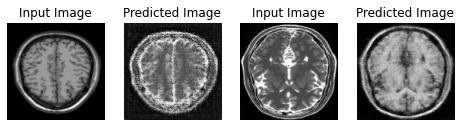

Saving checkpoint for epoch 26 at ./Trained_Model/ckpt-126


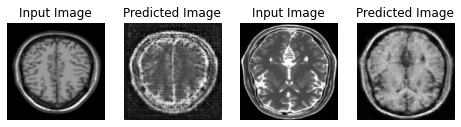

Saving checkpoint for epoch 27 at ./Trained_Model/ckpt-127


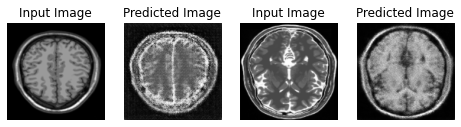

Saving checkpoint for epoch 28 at ./Trained_Model/ckpt-128


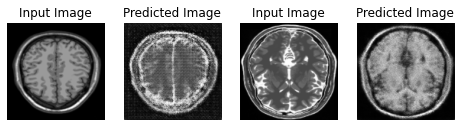

Saving checkpoint for epoch 29 at ./Trained_Model/ckpt-129


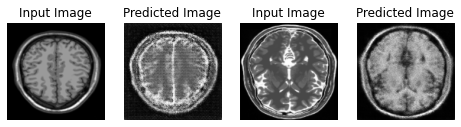

Saving checkpoint for epoch 30 at ./Trained_Model/ckpt-130


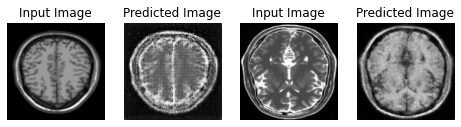

Saving checkpoint for epoch 31 at ./Trained_Model/ckpt-131


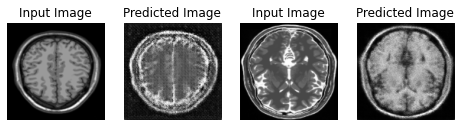

Saving checkpoint for epoch 32 at ./Trained_Model/ckpt-132


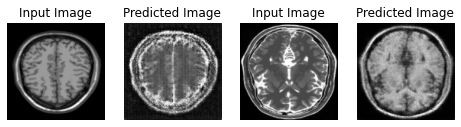

Saving checkpoint for epoch 33 at ./Trained_Model/ckpt-133


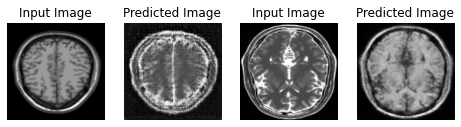

Saving checkpoint for epoch 34 at ./Trained_Model/ckpt-134


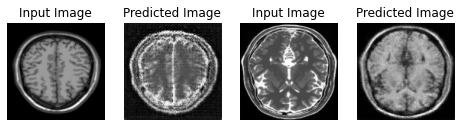

Saving checkpoint for epoch 35 at ./Trained_Model/ckpt-135


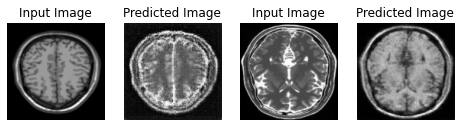

Saving checkpoint for epoch 36 at ./Trained_Model/ckpt-136


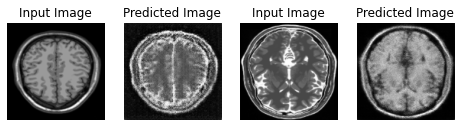

Saving checkpoint for epoch 37 at ./Trained_Model/ckpt-137


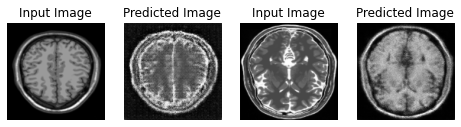

Saving checkpoint for epoch 38 at ./Trained_Model/ckpt-138


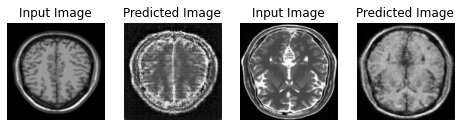

Saving checkpoint for epoch 39 at ./Trained_Model/ckpt-139


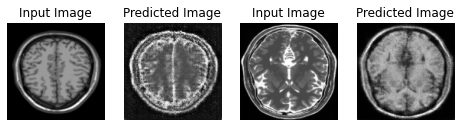

Saving checkpoint for epoch 40 at ./Trained_Model/ckpt-140


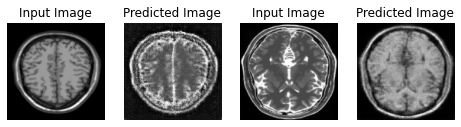

Saving checkpoint for epoch 41 at ./Trained_Model/ckpt-141


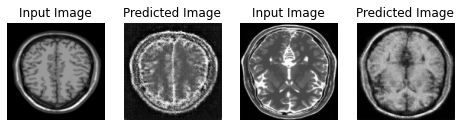

Saving checkpoint for epoch 42 at ./Trained_Model/ckpt-142


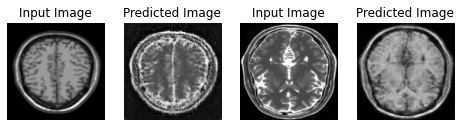

Saving checkpoint for epoch 43 at ./Trained_Model/ckpt-143


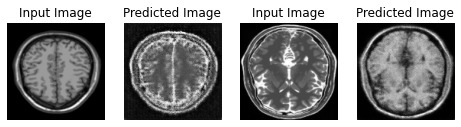

Saving checkpoint for epoch 44 at ./Trained_Model/ckpt-144


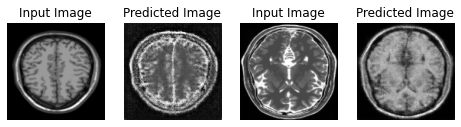

Saving checkpoint for epoch 45 at ./Trained_Model/ckpt-145


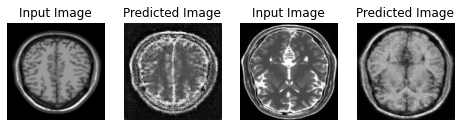

Saving checkpoint for epoch 46 at ./Trained_Model/ckpt-146


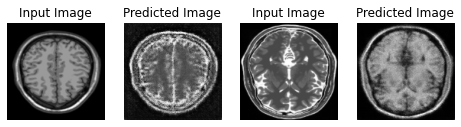

Saving checkpoint for epoch 47 at ./Trained_Model/ckpt-147


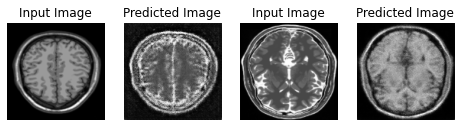

Saving checkpoint for epoch 48 at ./Trained_Model/ckpt-148


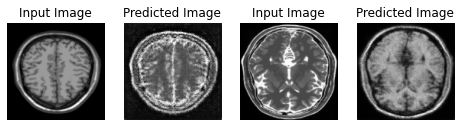

Saving checkpoint for epoch 49 at ./Trained_Model/ckpt-149


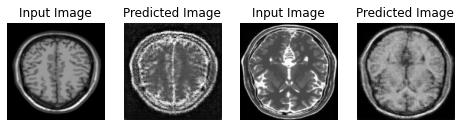

Saving checkpoint for epoch 50 at ./Trained_Model/ckpt-150


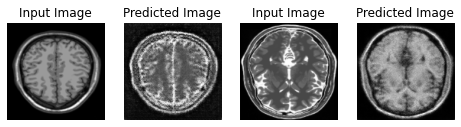

Saving checkpoint for epoch 51 at ./Trained_Model/ckpt-151


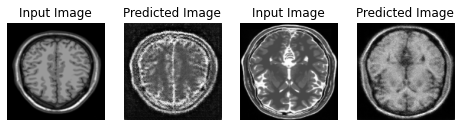

Saving checkpoint for epoch 52 at ./Trained_Model/ckpt-152


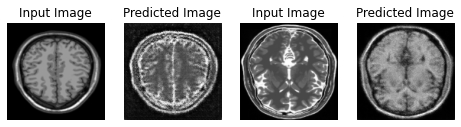

Saving checkpoint for epoch 53 at ./Trained_Model/ckpt-153


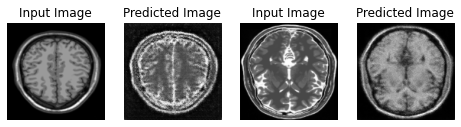

Saving checkpoint for epoch 54 at ./Trained_Model/ckpt-154


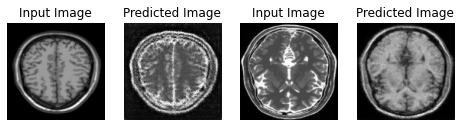

Saving checkpoint for epoch 55 at ./Trained_Model/ckpt-155


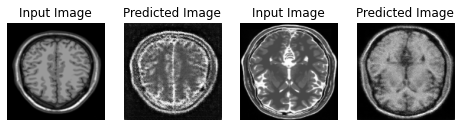

Saving checkpoint for epoch 56 at ./Trained_Model/ckpt-156


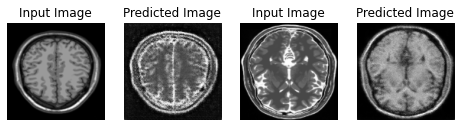

Saving checkpoint for epoch 57 at ./Trained_Model/ckpt-157


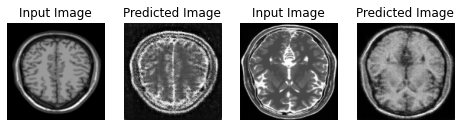

Saving checkpoint for epoch 58 at ./Trained_Model/ckpt-158


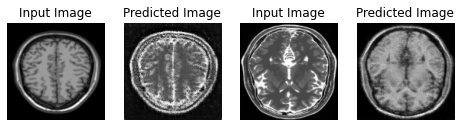

Saving checkpoint for epoch 59 at ./Trained_Model/ckpt-159


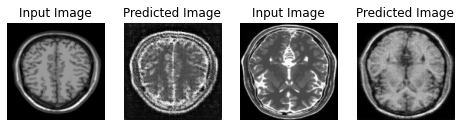

Saving checkpoint for epoch 60 at ./Trained_Model/ckpt-160


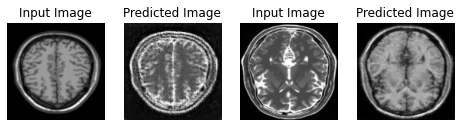

Saving checkpoint for epoch 61 at ./Trained_Model/ckpt-161


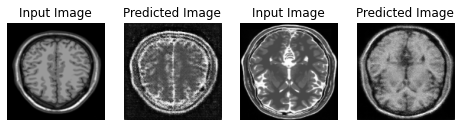

Saving checkpoint for epoch 62 at ./Trained_Model/ckpt-162


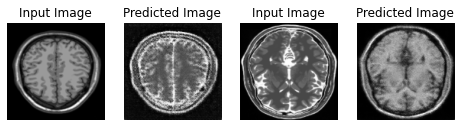

Saving checkpoint for epoch 63 at ./Trained_Model/ckpt-163


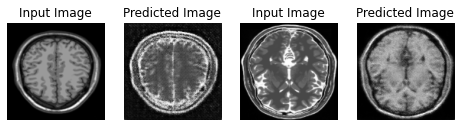

Saving checkpoint for epoch 64 at ./Trained_Model/ckpt-164


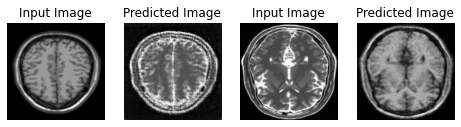

Saving checkpoint for epoch 65 at ./Trained_Model/ckpt-165


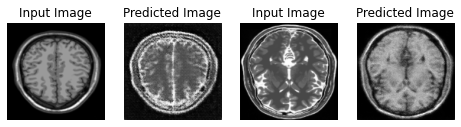

Saving checkpoint for epoch 66 at ./Trained_Model/ckpt-166


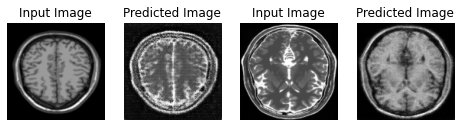

Saving checkpoint for epoch 67 at ./Trained_Model/ckpt-167


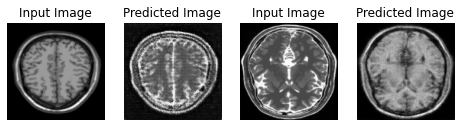

Saving checkpoint for epoch 68 at ./Trained_Model/ckpt-168


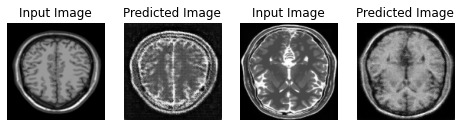

Saving checkpoint for epoch 69 at ./Trained_Model/ckpt-169


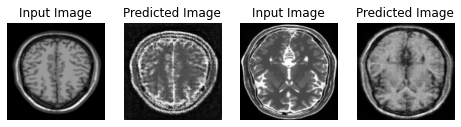

Saving checkpoint for epoch 70 at ./Trained_Model/ckpt-170


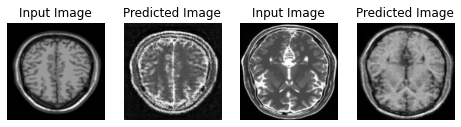

Saving checkpoint for epoch 71 at ./Trained_Model/ckpt-171


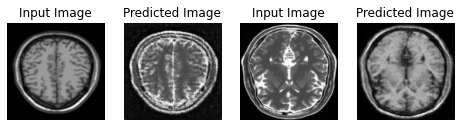

Saving checkpoint for epoch 72 at ./Trained_Model/ckpt-172


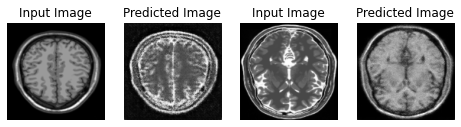

Saving checkpoint for epoch 73 at ./Trained_Model/ckpt-173


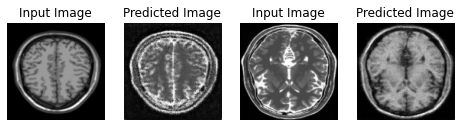

Saving checkpoint for epoch 74 at ./Trained_Model/ckpt-174


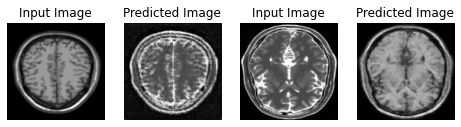

Saving checkpoint for epoch 75 at ./Trained_Model/ckpt-175


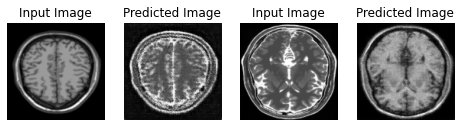

Saving checkpoint for epoch 76 at ./Trained_Model/ckpt-176


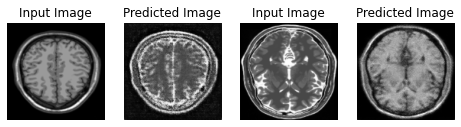

Saving checkpoint for epoch 77 at ./Trained_Model/ckpt-177


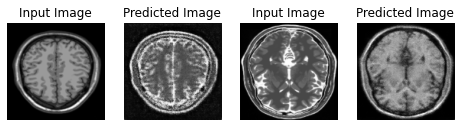

Saving checkpoint for epoch 78 at ./Trained_Model/ckpt-178


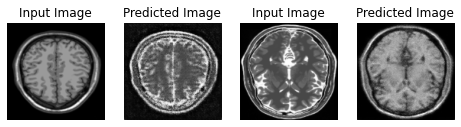

Saving checkpoint for epoch 79 at ./Trained_Model/ckpt-179


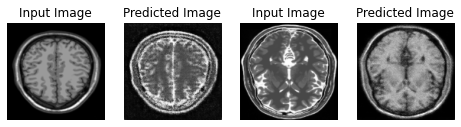

Saving checkpoint for epoch 80 at ./Trained_Model/ckpt-180


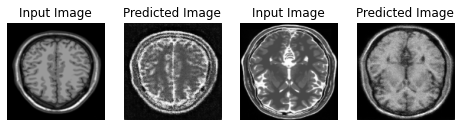

Saving checkpoint for epoch 81 at ./Trained_Model/ckpt-181


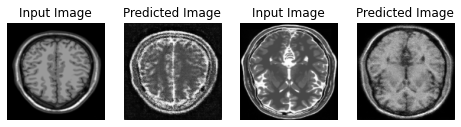

Saving checkpoint for epoch 82 at ./Trained_Model/ckpt-182


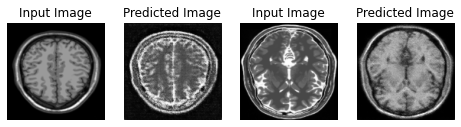

Saving checkpoint for epoch 83 at ./Trained_Model/ckpt-183


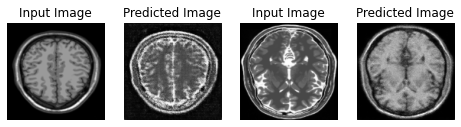

Saving checkpoint for epoch 84 at ./Trained_Model/ckpt-184


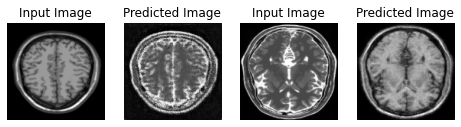

Saving checkpoint for epoch 85 at ./Trained_Model/ckpt-185


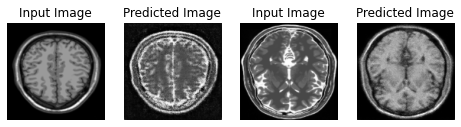

Saving checkpoint for epoch 86 at ./Trained_Model/ckpt-186


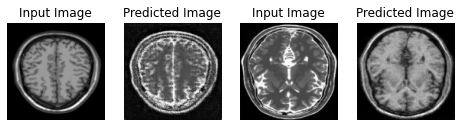

Saving checkpoint for epoch 87 at ./Trained_Model/ckpt-187


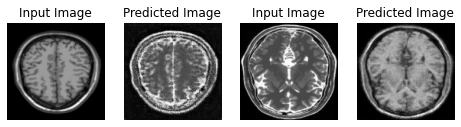

Saving checkpoint for epoch 88 at ./Trained_Model/ckpt-188


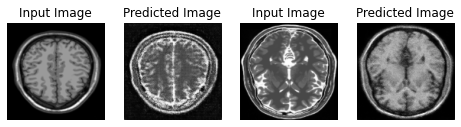

Saving checkpoint for epoch 89 at ./Trained_Model/ckpt-189


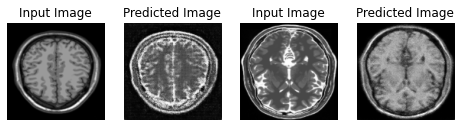

Saving checkpoint for epoch 90 at ./Trained_Model/ckpt-190


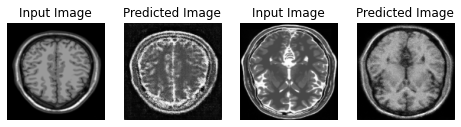

Saving checkpoint for epoch 91 at ./Trained_Model/ckpt-191


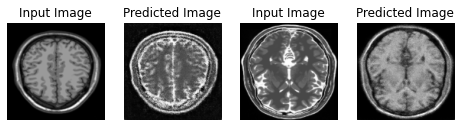

Saving checkpoint for epoch 92 at ./Trained_Model/ckpt-192


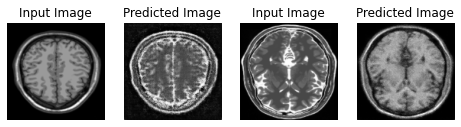

Saving checkpoint for epoch 93 at ./Trained_Model/ckpt-193


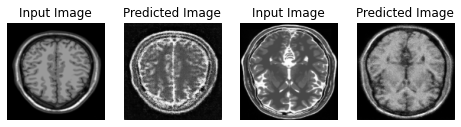

Saving checkpoint for epoch 94 at ./Trained_Model/ckpt-194


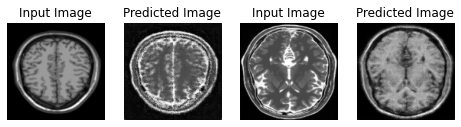

Saving checkpoint for epoch 95 at ./Trained_Model/ckpt-195


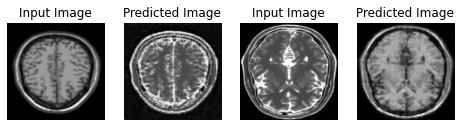

Saving checkpoint for epoch 96 at ./Trained_Model/ckpt-196


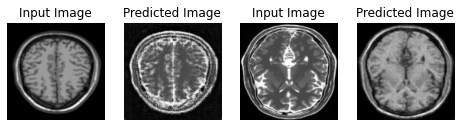

Saving checkpoint for epoch 97 at ./Trained_Model/ckpt-197


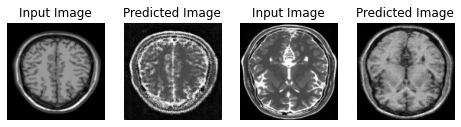

Saving checkpoint for epoch 98 at ./Trained_Model/ckpt-198


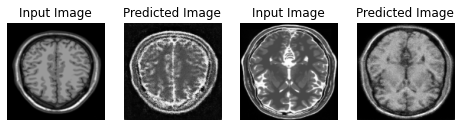

Saving checkpoint for epoch 99 at ./Trained_Model/ckpt-199


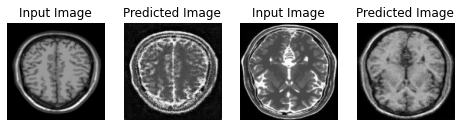

Saving checkpoint for epoch 100 at ./Trained_Model/ckpt-200


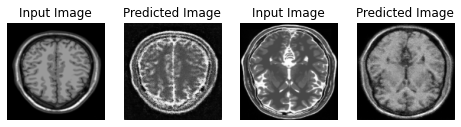

Saving checkpoint for epoch 101 at ./Trained_Model/ckpt-201


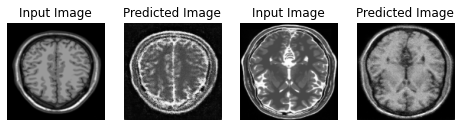

Saving checkpoint for epoch 102 at ./Trained_Model/ckpt-202


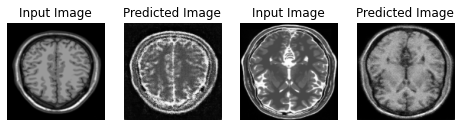

Saving checkpoint for epoch 103 at ./Trained_Model/ckpt-203


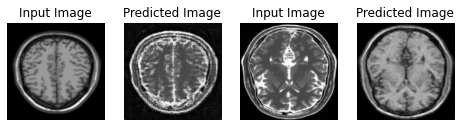

Saving checkpoint for epoch 104 at ./Trained_Model/ckpt-204


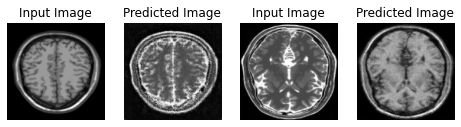

Saving checkpoint for epoch 105 at ./Trained_Model/ckpt-205


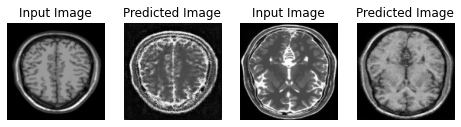

Saving checkpoint for epoch 106 at ./Trained_Model/ckpt-206


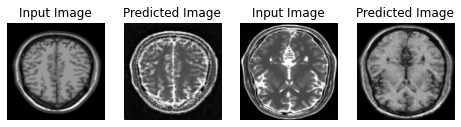

Saving checkpoint for epoch 107 at ./Trained_Model/ckpt-207


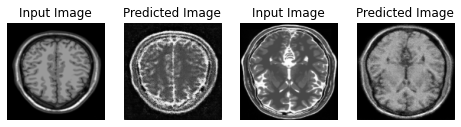

Saving checkpoint for epoch 108 at ./Trained_Model/ckpt-208


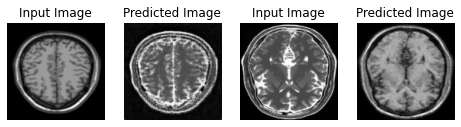

Saving checkpoint for epoch 109 at ./Trained_Model/ckpt-209


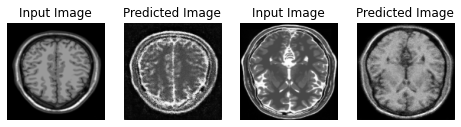

Saving checkpoint for epoch 110 at ./Trained_Model/ckpt-210


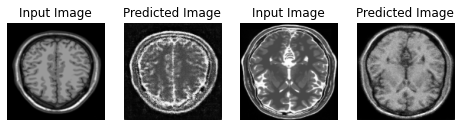

Saving checkpoint for epoch 111 at ./Trained_Model/ckpt-211


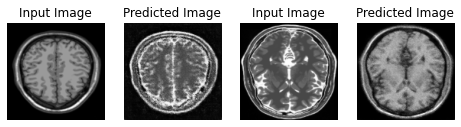

Saving checkpoint for epoch 112 at ./Trained_Model/ckpt-212


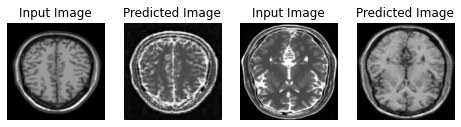

Saving checkpoint for epoch 113 at ./Trained_Model/ckpt-213


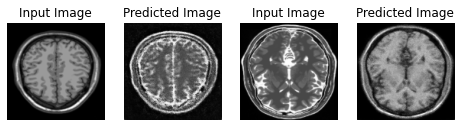

Saving checkpoint for epoch 114 at ./Trained_Model/ckpt-214


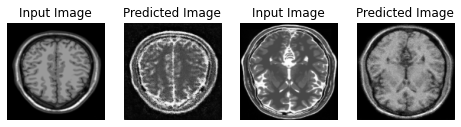

Saving checkpoint for epoch 115 at ./Trained_Model/ckpt-215


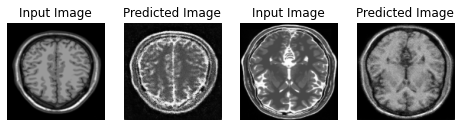

Saving checkpoint for epoch 116 at ./Trained_Model/ckpt-216


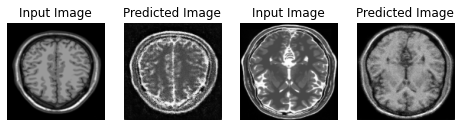

Saving checkpoint for epoch 117 at ./Trained_Model/ckpt-217


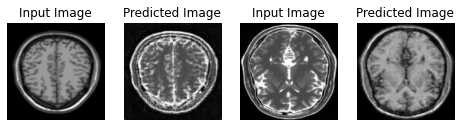

Saving checkpoint for epoch 118 at ./Trained_Model/ckpt-218


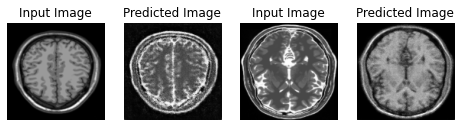

Saving checkpoint for epoch 119 at ./Trained_Model/ckpt-219


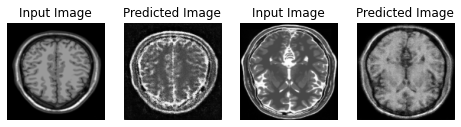

Saving checkpoint for epoch 120 at ./Trained_Model/ckpt-220


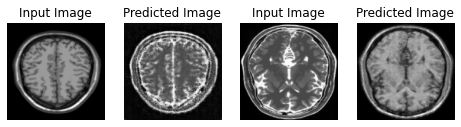

Saving checkpoint for epoch 121 at ./Trained_Model/ckpt-221


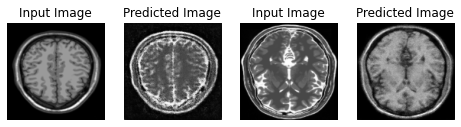

Saving checkpoint for epoch 122 at ./Trained_Model/ckpt-222


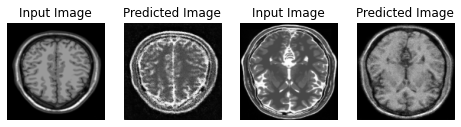

Saving checkpoint for epoch 123 at ./Trained_Model/ckpt-223


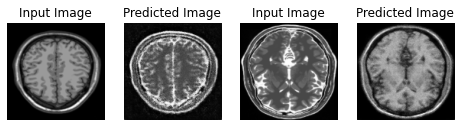

Saving checkpoint for epoch 124 at ./Trained_Model/ckpt-224


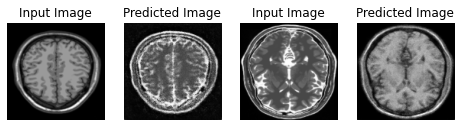

Saving checkpoint for epoch 125 at ./Trained_Model/ckpt-225


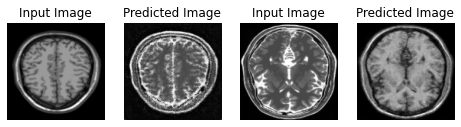

Saving checkpoint for epoch 126 at ./Trained_Model/ckpt-226


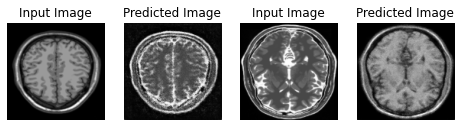

Saving checkpoint for epoch 127 at ./Trained_Model/ckpt-227


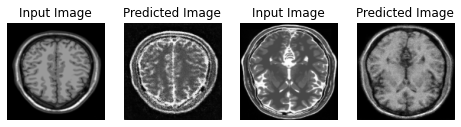

Saving checkpoint for epoch 128 at ./Trained_Model/ckpt-228


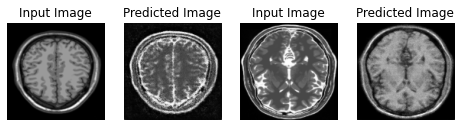

Saving checkpoint for epoch 129 at ./Trained_Model/ckpt-229


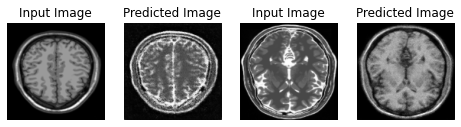

Saving checkpoint for epoch 130 at ./Trained_Model/ckpt-230


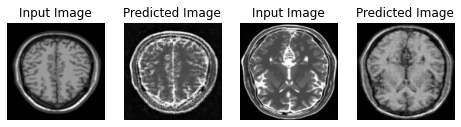

Saving checkpoint for epoch 131 at ./Trained_Model/ckpt-231


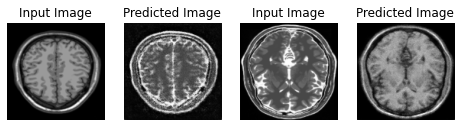

Saving checkpoint for epoch 132 at ./Trained_Model/ckpt-232


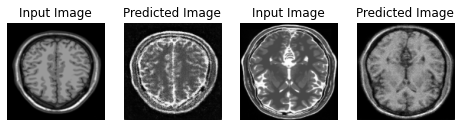

Saving checkpoint for epoch 133 at ./Trained_Model/ckpt-233


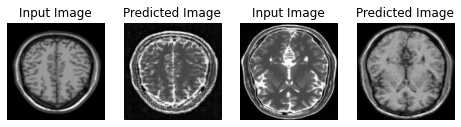

Saving checkpoint for epoch 134 at ./Trained_Model/ckpt-234


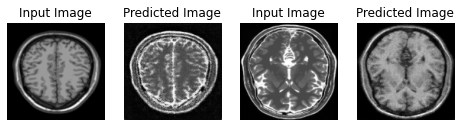

Saving checkpoint for epoch 135 at ./Trained_Model/ckpt-235


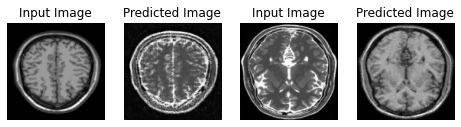

Saving checkpoint for epoch 136 at ./Trained_Model/ckpt-236


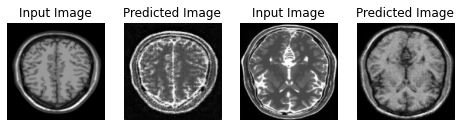

Saving checkpoint for epoch 137 at ./Trained_Model/ckpt-237


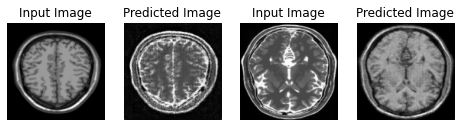

Saving checkpoint for epoch 138 at ./Trained_Model/ckpt-238


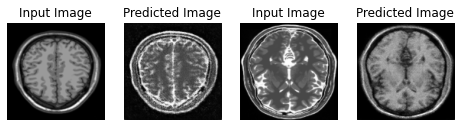

Saving checkpoint for epoch 139 at ./Trained_Model/ckpt-239


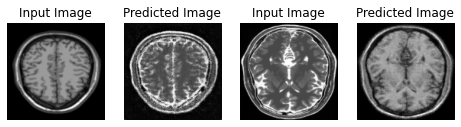

Saving checkpoint for epoch 140 at ./Trained_Model/ckpt-240


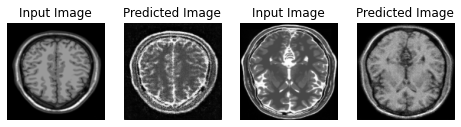

Saving checkpoint for epoch 141 at ./Trained_Model/ckpt-241


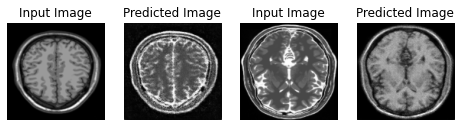

Saving checkpoint for epoch 142 at ./Trained_Model/ckpt-242


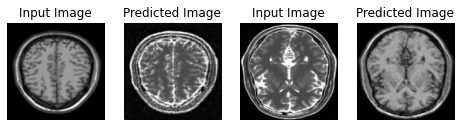

Saving checkpoint for epoch 143 at ./Trained_Model/ckpt-243


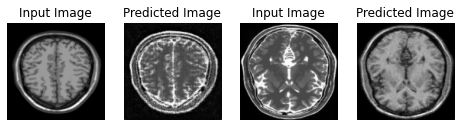

Saving checkpoint for epoch 144 at ./Trained_Model/ckpt-244


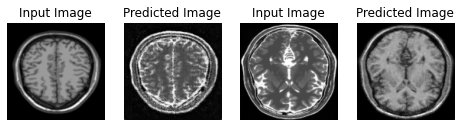

Saving checkpoint for epoch 145 at ./Trained_Model/ckpt-245


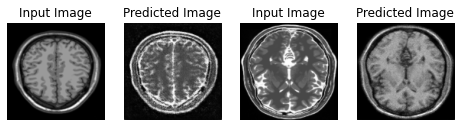

Saving checkpoint for epoch 146 at ./Trained_Model/ckpt-246


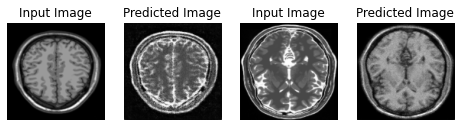

Saving checkpoint for epoch 147 at ./Trained_Model/ckpt-247


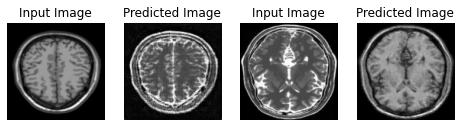

Saving checkpoint for epoch 148 at ./Trained_Model/ckpt-248


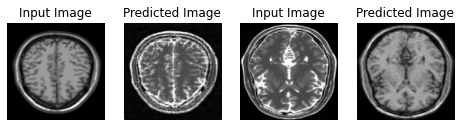

Saving checkpoint for epoch 149 at ./Trained_Model/ckpt-249


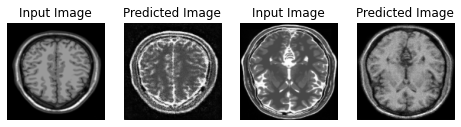

Saving checkpoint for epoch 150 at ./Trained_Model/ckpt-250


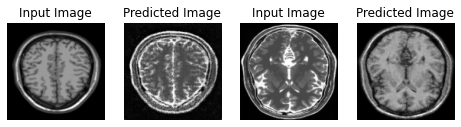

Saving checkpoint for epoch 151 at ./Trained_Model/ckpt-251


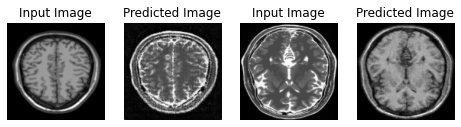

Saving checkpoint for epoch 152 at ./Trained_Model/ckpt-252


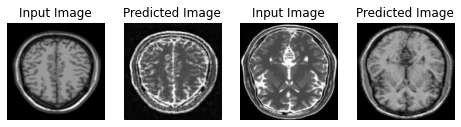

Saving checkpoint for epoch 153 at ./Trained_Model/ckpt-253


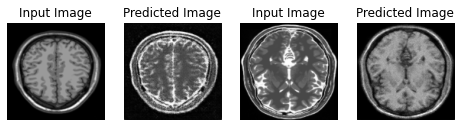

Saving checkpoint for epoch 154 at ./Trained_Model/ckpt-254


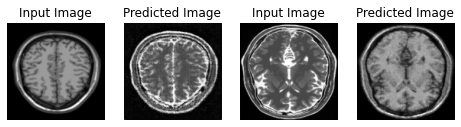

Saving checkpoint for epoch 155 at ./Trained_Model/ckpt-255


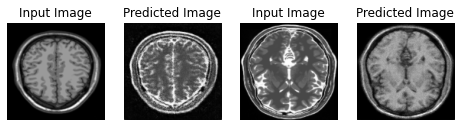

Saving checkpoint for epoch 156 at ./Trained_Model/ckpt-256


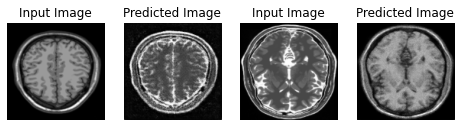

Saving checkpoint for epoch 157 at ./Trained_Model/ckpt-257


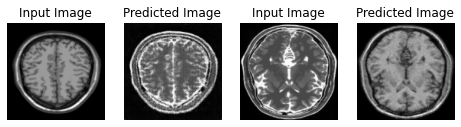

Saving checkpoint for epoch 158 at ./Trained_Model/ckpt-258


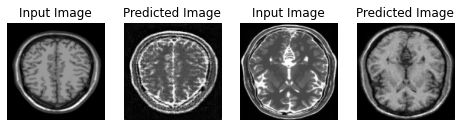

Saving checkpoint for epoch 159 at ./Trained_Model/ckpt-259


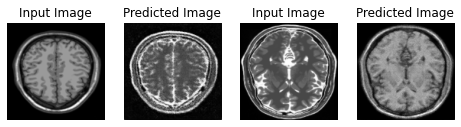

Saving checkpoint for epoch 160 at ./Trained_Model/ckpt-260


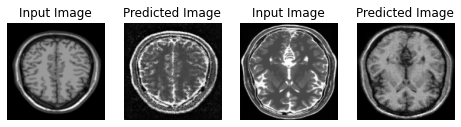

Saving checkpoint for epoch 161 at ./Trained_Model/ckpt-261


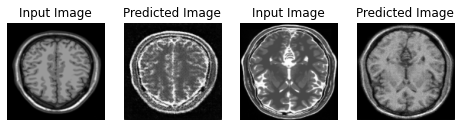

Saving checkpoint for epoch 162 at ./Trained_Model/ckpt-262


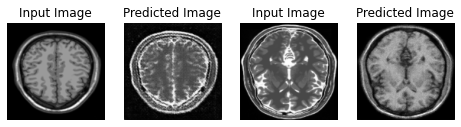

Saving checkpoint for epoch 163 at ./Trained_Model/ckpt-263


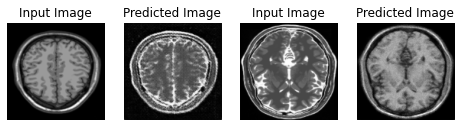

Saving checkpoint for epoch 164 at ./Trained_Model/ckpt-264


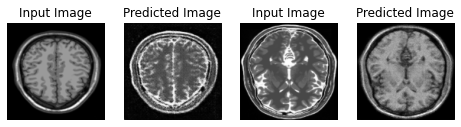

Saving checkpoint for epoch 165 at ./Trained_Model/ckpt-265


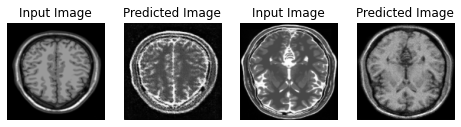

Saving checkpoint for epoch 166 at ./Trained_Model/ckpt-266


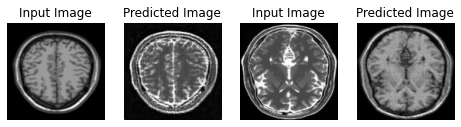

Saving checkpoint for epoch 167 at ./Trained_Model/ckpt-267


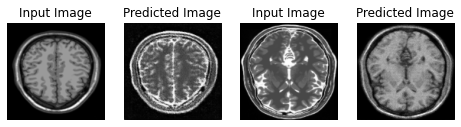

Saving checkpoint for epoch 168 at ./Trained_Model/ckpt-268


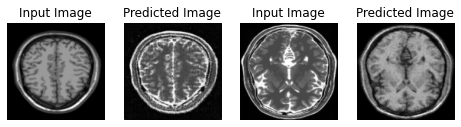

Saving checkpoint for epoch 169 at ./Trained_Model/ckpt-269


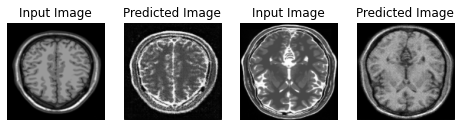

Saving checkpoint for epoch 170 at ./Trained_Model/ckpt-270


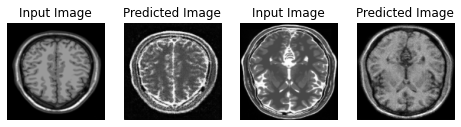

Saving checkpoint for epoch 171 at ./Trained_Model/ckpt-271


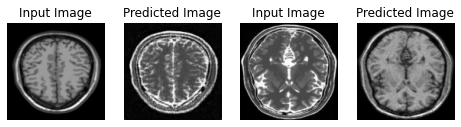

Saving checkpoint for epoch 172 at ./Trained_Model/ckpt-272


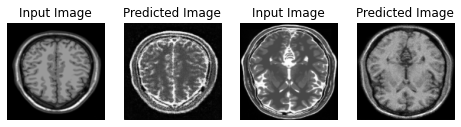

Saving checkpoint for epoch 173 at ./Trained_Model/ckpt-273


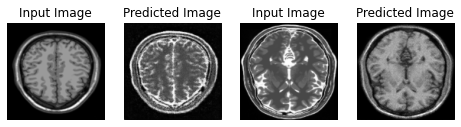

Saving checkpoint for epoch 174 at ./Trained_Model/ckpt-274


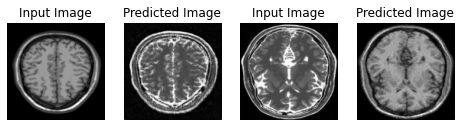

Saving checkpoint for epoch 175 at ./Trained_Model/ckpt-275


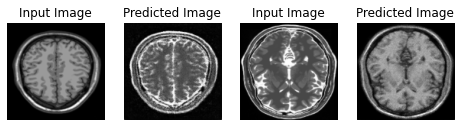

Saving checkpoint for epoch 176 at ./Trained_Model/ckpt-276


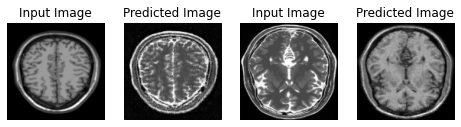

Saving checkpoint for epoch 177 at ./Trained_Model/ckpt-277


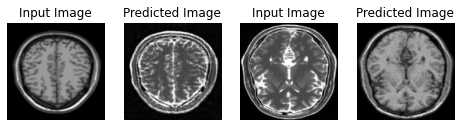

Saving checkpoint for epoch 178 at ./Trained_Model/ckpt-278


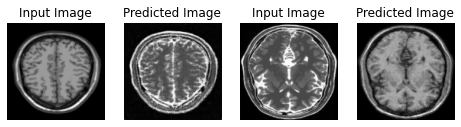

Saving checkpoint for epoch 179 at ./Trained_Model/ckpt-279


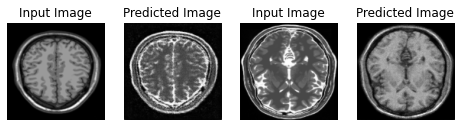

Saving checkpoint for epoch 180 at ./Trained_Model/ckpt-280


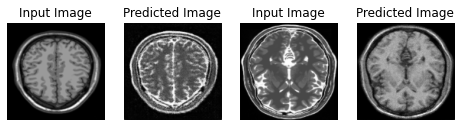

Saving checkpoint for epoch 181 at ./Trained_Model/ckpt-281


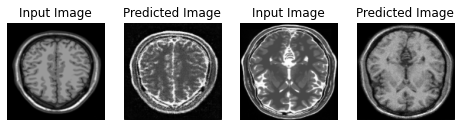

Saving checkpoint for epoch 182 at ./Trained_Model/ckpt-282


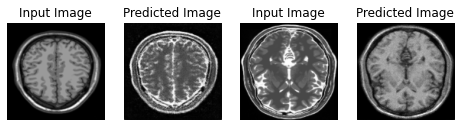

Saving checkpoint for epoch 183 at ./Trained_Model/ckpt-283


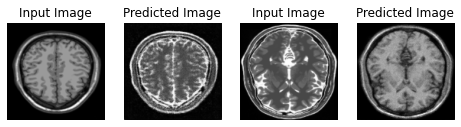

Saving checkpoint for epoch 184 at ./Trained_Model/ckpt-284


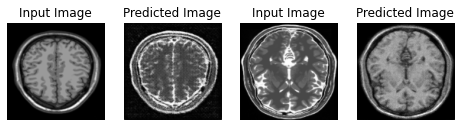

Saving checkpoint for epoch 185 at ./Trained_Model/ckpt-285


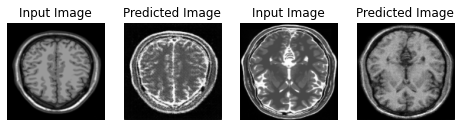

Saving checkpoint for epoch 186 at ./Trained_Model/ckpt-286


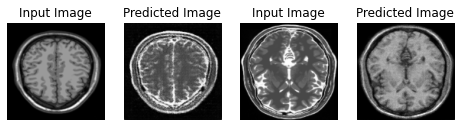

Saving checkpoint for epoch 187 at ./Trained_Model/ckpt-287


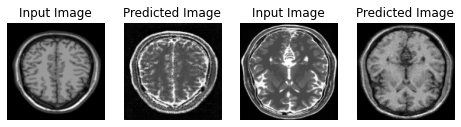

Saving checkpoint for epoch 188 at ./Trained_Model/ckpt-288


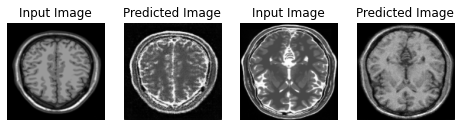

Saving checkpoint for epoch 189 at ./Trained_Model/ckpt-289


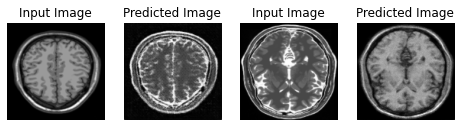

Saving checkpoint for epoch 190 at ./Trained_Model/ckpt-290


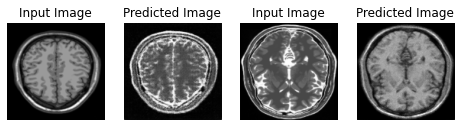

Saving checkpoint for epoch 191 at ./Trained_Model/ckpt-291


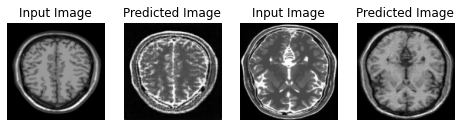

Saving checkpoint for epoch 192 at ./Trained_Model/ckpt-292


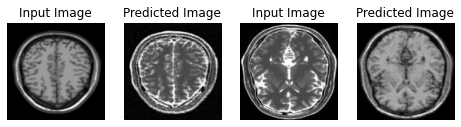

Saving checkpoint for epoch 193 at ./Trained_Model/ckpt-293


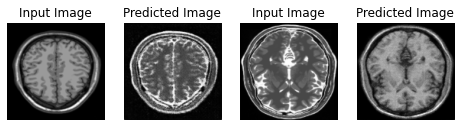

Saving checkpoint for epoch 194 at ./Trained_Model/ckpt-294


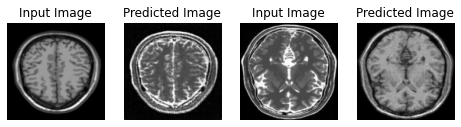

Saving checkpoint for epoch 195 at ./Trained_Model/ckpt-295


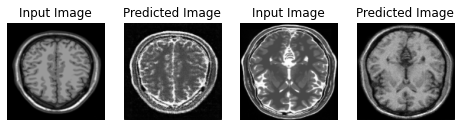

Saving checkpoint for epoch 196 at ./Trained_Model/ckpt-296


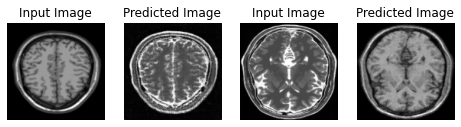

Saving checkpoint for epoch 197 at ./Trained_Model/ckpt-297


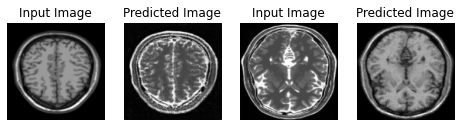

Saving checkpoint for epoch 198 at ./Trained_Model/ckpt-298


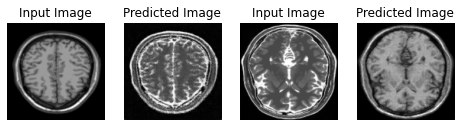

Saving checkpoint for epoch 199 at ./Trained_Model/ckpt-299


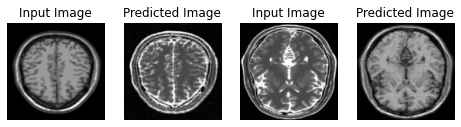

Saving checkpoint for epoch 200 at ./Trained_Model/ckpt-300


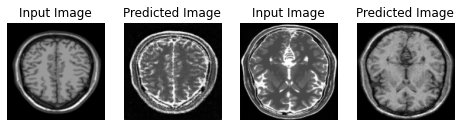

Saving checkpoint for epoch 201 at ./Trained_Model/ckpt-301


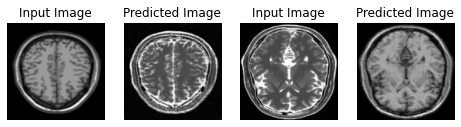

Saving checkpoint for epoch 202 at ./Trained_Model/ckpt-302


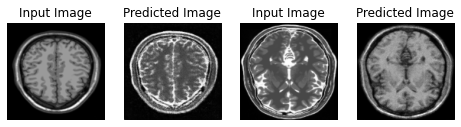

Saving checkpoint for epoch 203 at ./Trained_Model/ckpt-303


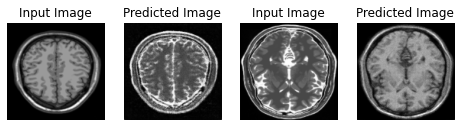

Saving checkpoint for epoch 204 at ./Trained_Model/ckpt-304


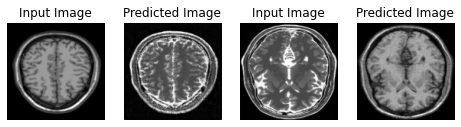

Saving checkpoint for epoch 205 at ./Trained_Model/ckpt-305


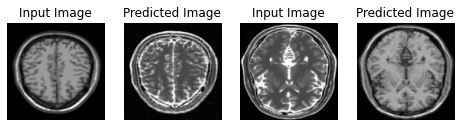

Saving checkpoint for epoch 206 at ./Trained_Model/ckpt-306


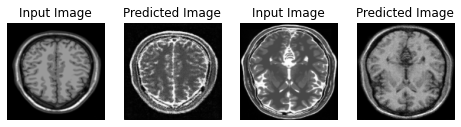

Saving checkpoint for epoch 207 at ./Trained_Model/ckpt-307


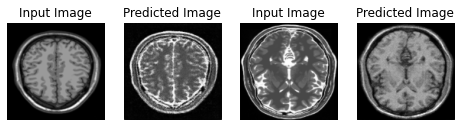

Saving checkpoint for epoch 208 at ./Trained_Model/ckpt-308


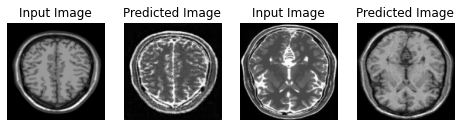

Saving checkpoint for epoch 209 at ./Trained_Model/ckpt-309


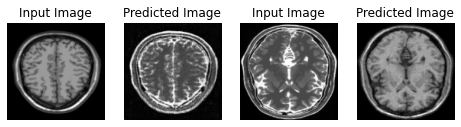

Saving checkpoint for epoch 210 at ./Trained_Model/ckpt-310


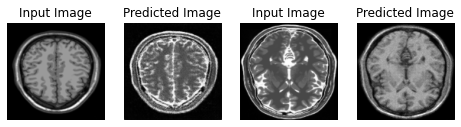

Saving checkpoint for epoch 211 at ./Trained_Model/ckpt-311


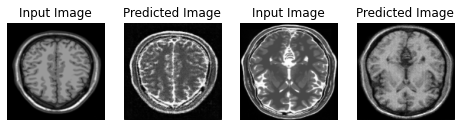

Saving checkpoint for epoch 212 at ./Trained_Model/ckpt-312


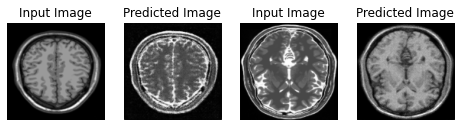

Saving checkpoint for epoch 213 at ./Trained_Model/ckpt-313


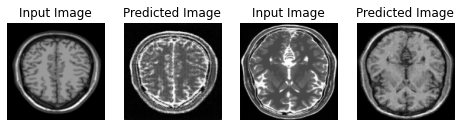

Saving checkpoint for epoch 214 at ./Trained_Model/ckpt-314


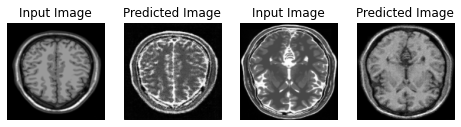

Saving checkpoint for epoch 215 at ./Trained_Model/ckpt-315


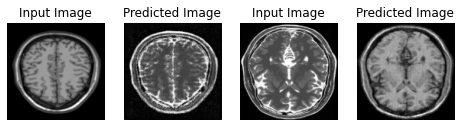

Saving checkpoint for epoch 216 at ./Trained_Model/ckpt-316


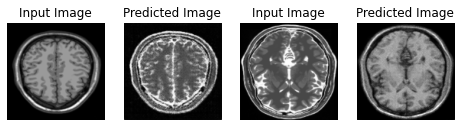

Saving checkpoint for epoch 217 at ./Trained_Model/ckpt-317


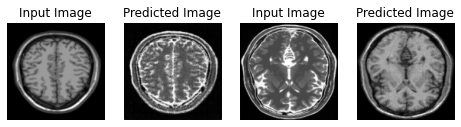

Saving checkpoint for epoch 218 at ./Trained_Model/ckpt-318


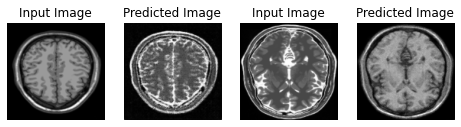

Saving checkpoint for epoch 219 at ./Trained_Model/ckpt-319


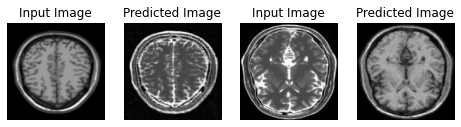

Saving checkpoint for epoch 220 at ./Trained_Model/ckpt-320


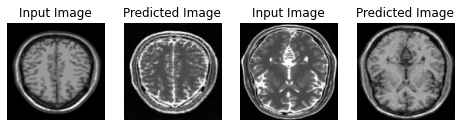

Saving checkpoint for epoch 221 at ./Trained_Model/ckpt-321


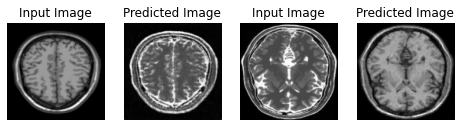

Saving checkpoint for epoch 222 at ./Trained_Model/ckpt-322


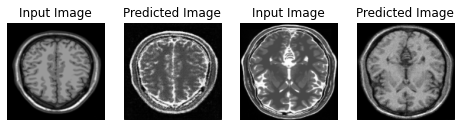

Saving checkpoint for epoch 223 at ./Trained_Model/ckpt-323


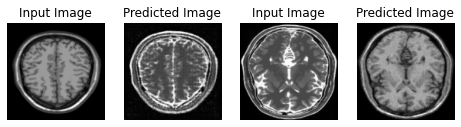

Saving checkpoint for epoch 224 at ./Trained_Model/ckpt-324


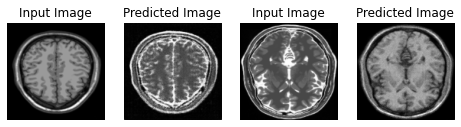

Saving checkpoint for epoch 225 at ./Trained_Model/ckpt-325


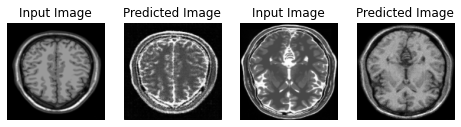

Saving checkpoint for epoch 226 at ./Trained_Model/ckpt-326


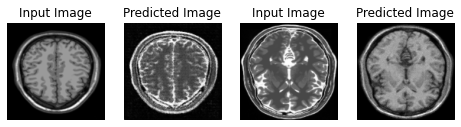

Saving checkpoint for epoch 227 at ./Trained_Model/ckpt-327


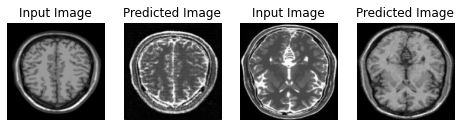

Saving checkpoint for epoch 228 at ./Trained_Model/ckpt-328


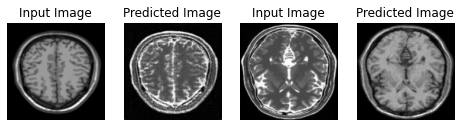

Saving checkpoint for epoch 229 at ./Trained_Model/ckpt-329


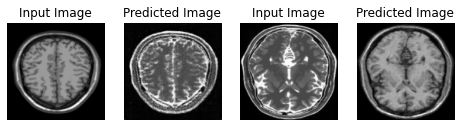

Saving checkpoint for epoch 230 at ./Trained_Model/ckpt-330


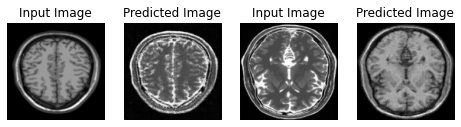

Saving checkpoint for epoch 231 at ./Trained_Model/ckpt-331


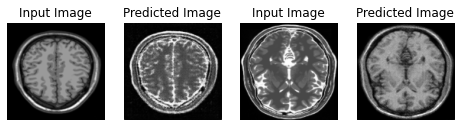

Saving checkpoint for epoch 232 at ./Trained_Model/ckpt-332


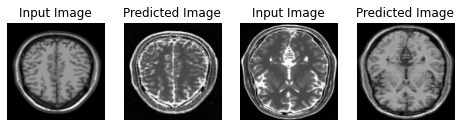

Saving checkpoint for epoch 233 at ./Trained_Model/ckpt-333


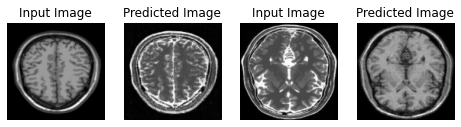

Saving checkpoint for epoch 234 at ./Trained_Model/ckpt-334


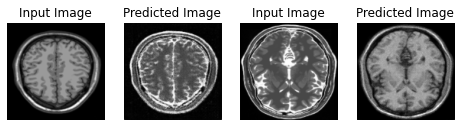

Saving checkpoint for epoch 235 at ./Trained_Model/ckpt-335


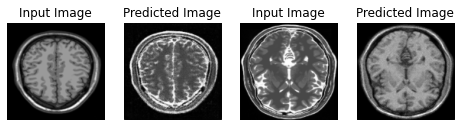

Saving checkpoint for epoch 236 at ./Trained_Model/ckpt-336


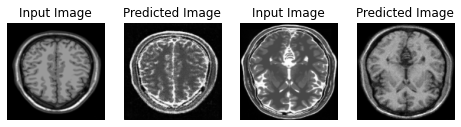

Saving checkpoint for epoch 237 at ./Trained_Model/ckpt-337


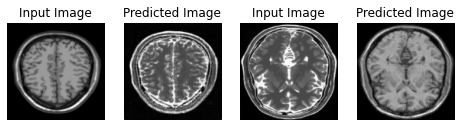

Saving checkpoint for epoch 238 at ./Trained_Model/ckpt-338


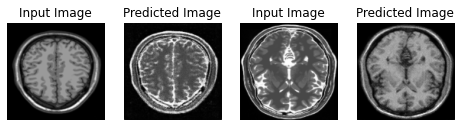

Saving checkpoint for epoch 239 at ./Trained_Model/ckpt-339


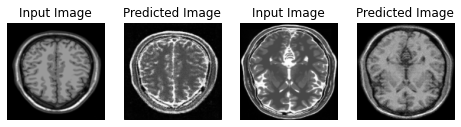

Saving checkpoint for epoch 240 at ./Trained_Model/ckpt-340


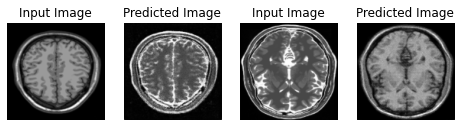

Saving checkpoint for epoch 241 at ./Trained_Model/ckpt-341


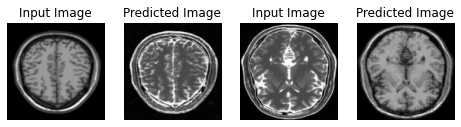

Saving checkpoint for epoch 242 at ./Trained_Model/ckpt-342


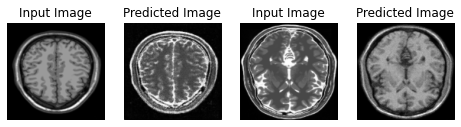

Saving checkpoint for epoch 243 at ./Trained_Model/ckpt-343


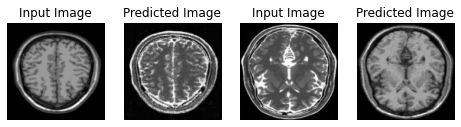

Saving checkpoint for epoch 244 at ./Trained_Model/ckpt-344


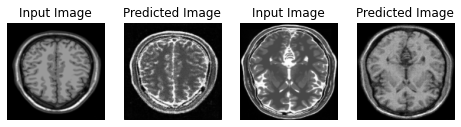

Saving checkpoint for epoch 245 at ./Trained_Model/ckpt-345


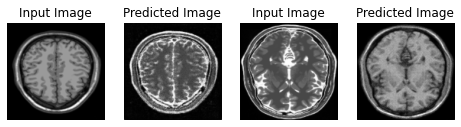

Saving checkpoint for epoch 246 at ./Trained_Model/ckpt-346


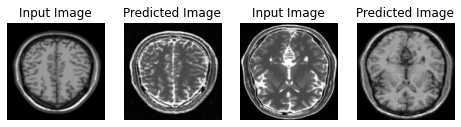

Saving checkpoint for epoch 247 at ./Trained_Model/ckpt-347


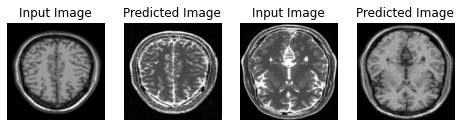

Saving checkpoint for epoch 248 at ./Trained_Model/ckpt-348


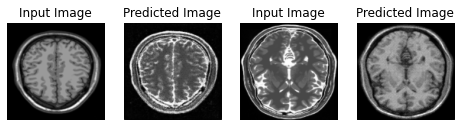

Saving checkpoint for epoch 249 at ./Trained_Model/ckpt-349


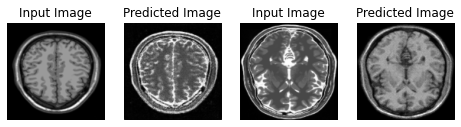

Saving checkpoint for epoch 250 at ./Trained_Model/ckpt-350


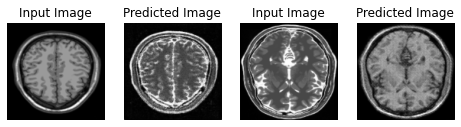

Saving checkpoint for epoch 251 at ./Trained_Model/ckpt-351


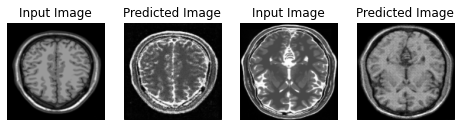

Saving checkpoint for epoch 252 at ./Trained_Model/ckpt-352


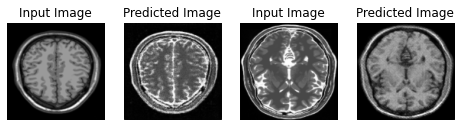

Saving checkpoint for epoch 253 at ./Trained_Model/ckpt-353


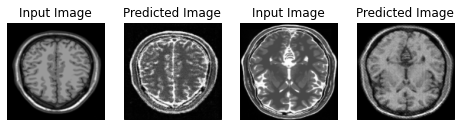

Saving checkpoint for epoch 254 at ./Trained_Model/ckpt-354


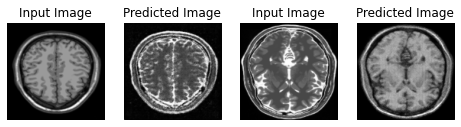

Saving checkpoint for epoch 255 at ./Trained_Model/ckpt-355


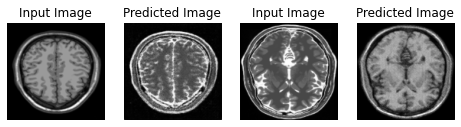

Saving checkpoint for epoch 256 at ./Trained_Model/ckpt-356


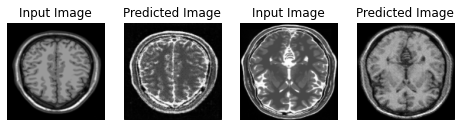

Saving checkpoint for epoch 257 at ./Trained_Model/ckpt-357


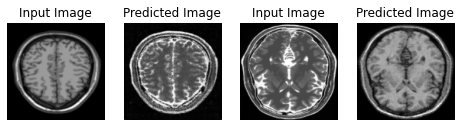

Saving checkpoint for epoch 258 at ./Trained_Model/ckpt-358


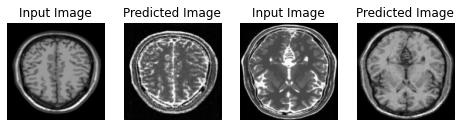

Saving checkpoint for epoch 259 at ./Trained_Model/ckpt-359


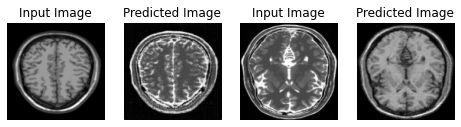

Saving checkpoint for epoch 260 at ./Trained_Model/ckpt-360


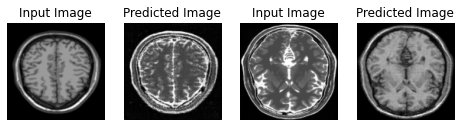

Saving checkpoint for epoch 261 at ./Trained_Model/ckpt-361


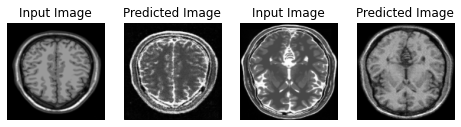

Saving checkpoint for epoch 262 at ./Trained_Model/ckpt-362


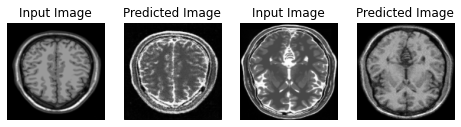

Saving checkpoint for epoch 263 at ./Trained_Model/ckpt-363


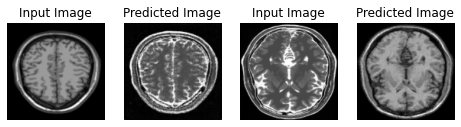

Saving checkpoint for epoch 264 at ./Trained_Model/ckpt-364


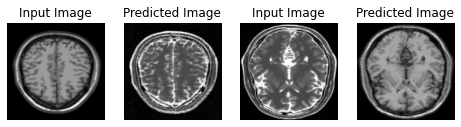

Saving checkpoint for epoch 265 at ./Trained_Model/ckpt-365


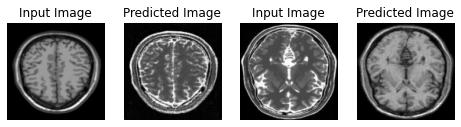

Saving checkpoint for epoch 266 at ./Trained_Model/ckpt-366


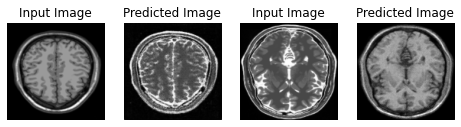

Saving checkpoint for epoch 267 at ./Trained_Model/ckpt-367


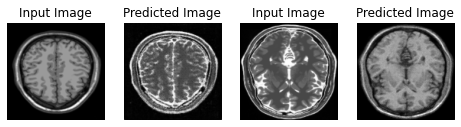

Saving checkpoint for epoch 268 at ./Trained_Model/ckpt-368


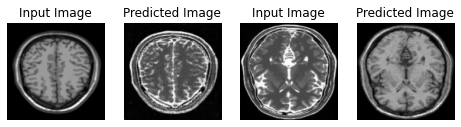

Saving checkpoint for epoch 269 at ./Trained_Model/ckpt-369


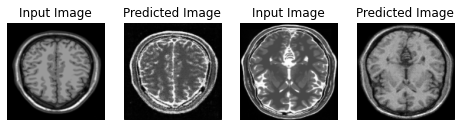

Saving checkpoint for epoch 270 at ./Trained_Model/ckpt-370


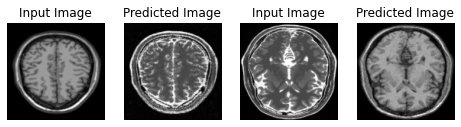

Saving checkpoint for epoch 271 at ./Trained_Model/ckpt-371


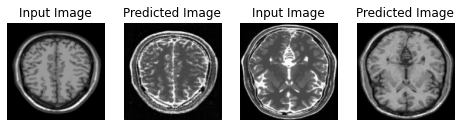

Saving checkpoint for epoch 272 at ./Trained_Model/ckpt-372


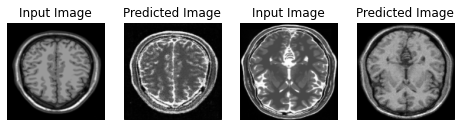

Saving checkpoint for epoch 273 at ./Trained_Model/ckpt-373


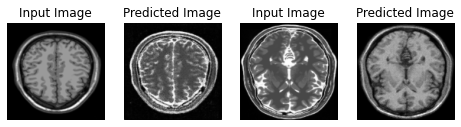

Saving checkpoint for epoch 274 at ./Trained_Model/ckpt-374


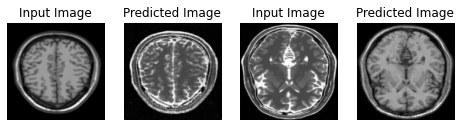

Saving checkpoint for epoch 275 at ./Trained_Model/ckpt-375


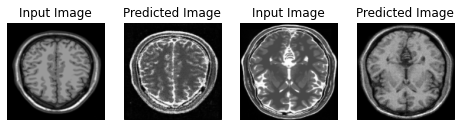

Saving checkpoint for epoch 276 at ./Trained_Model/ckpt-376


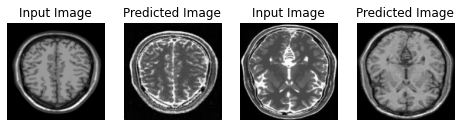

Saving checkpoint for epoch 277 at ./Trained_Model/ckpt-377


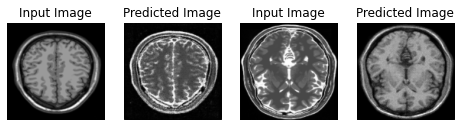

Saving checkpoint for epoch 278 at ./Trained_Model/ckpt-378


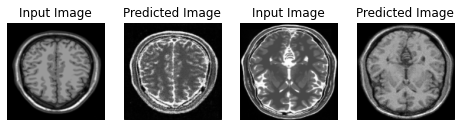

Saving checkpoint for epoch 279 at ./Trained_Model/ckpt-379


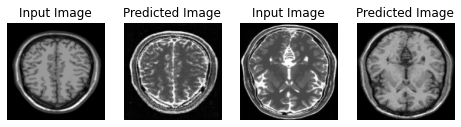

Saving checkpoint for epoch 280 at ./Trained_Model/ckpt-380


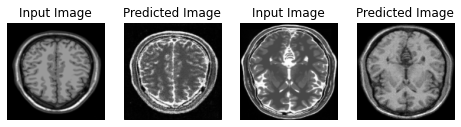

Saving checkpoint for epoch 281 at ./Trained_Model/ckpt-381


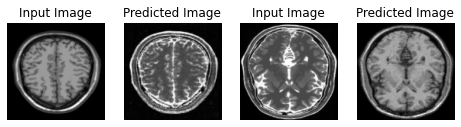

Saving checkpoint for epoch 282 at ./Trained_Model/ckpt-382


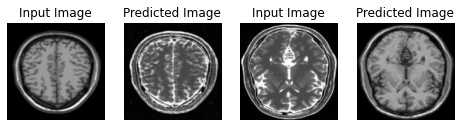

Saving checkpoint for epoch 283 at ./Trained_Model/ckpt-383


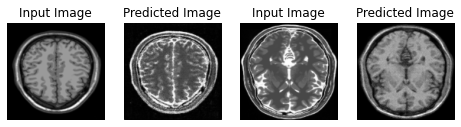

Saving checkpoint for epoch 284 at ./Trained_Model/ckpt-384


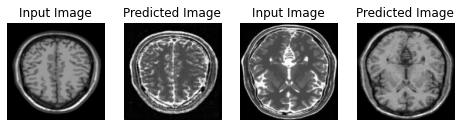

Saving checkpoint for epoch 285 at ./Trained_Model/ckpt-385


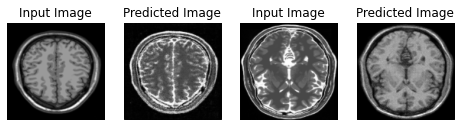

Saving checkpoint for epoch 286 at ./Trained_Model/ckpt-386


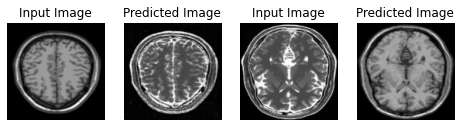

Saving checkpoint for epoch 287 at ./Trained_Model/ckpt-387


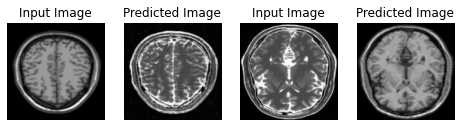

Saving checkpoint for epoch 288 at ./Trained_Model/ckpt-388


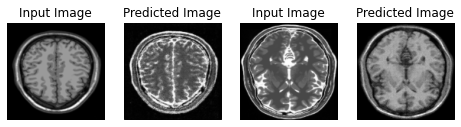

Saving checkpoint for epoch 289 at ./Trained_Model/ckpt-389


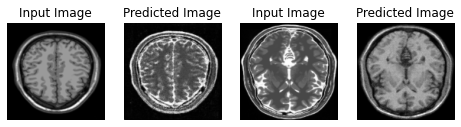

Saving checkpoint for epoch 290 at ./Trained_Model/ckpt-390


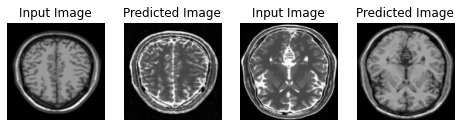

Saving checkpoint for epoch 291 at ./Trained_Model/ckpt-391


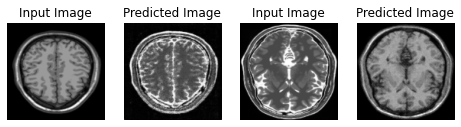

Saving checkpoint for epoch 292 at ./Trained_Model/ckpt-392


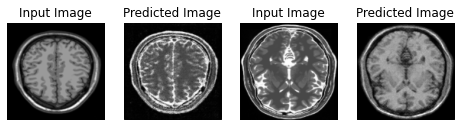

Saving checkpoint for epoch 293 at ./Trained_Model/ckpt-393


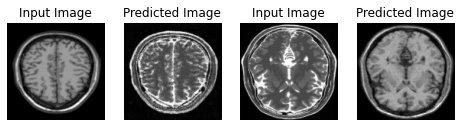

Saving checkpoint for epoch 294 at ./Trained_Model/ckpt-394


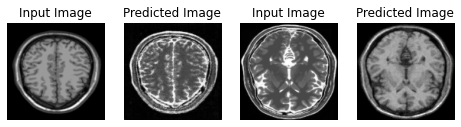

Saving checkpoint for epoch 295 at ./Trained_Model/ckpt-395


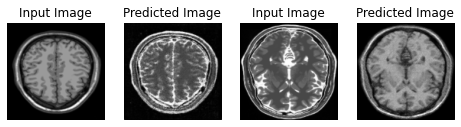

Saving checkpoint for epoch 296 at ./Trained_Model/ckpt-396


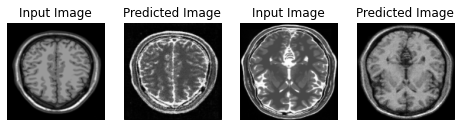

Saving checkpoint for epoch 297 at ./Trained_Model/ckpt-397


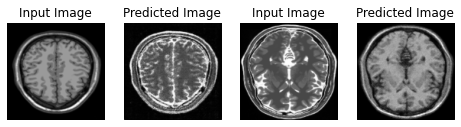

Saving checkpoint for epoch 298 at ./Trained_Model/ckpt-398


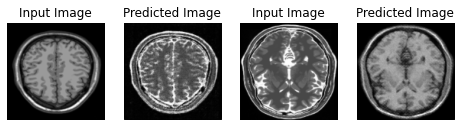

Saving checkpoint for epoch 299 at ./Trained_Model/ckpt-399


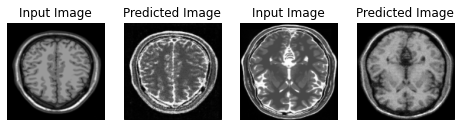

Saving checkpoint for epoch 300 at ./Trained_Model/ckpt-400


In [61]:
for epoch in range(1, EPOCHS+1):
    for image_x, image_y in tf.data.Dataset.zip((Tr1_data, Tr2_data)):
        train_step(image_x, image_y)
    generate_images(generator_g, sample_T1_data, generator_f, sample_T2_data)
    ckpt_save_path = ckpt_manager.save()
    print('Saving checkpoint for epoch', epoch, 'at', ckpt_save_path)

### Generating a GIF for visualization of Results
Notice the Quality of results we are getting.

In [62]:
anim_file = 'MRI_cyclegan.gif'

with imageio.get_writer(anim_file, mode='I') as writer:
  filenames = glob.glob('image*.png')
  filenames = sorted(filenames)
  for filename in filenames:
    image = imageio.imread(filename)
    writer.append_data(image)
  image = imageio.imread(filename)
  writer.append_data(image)

In [66]:
from IPython.display import Image, display

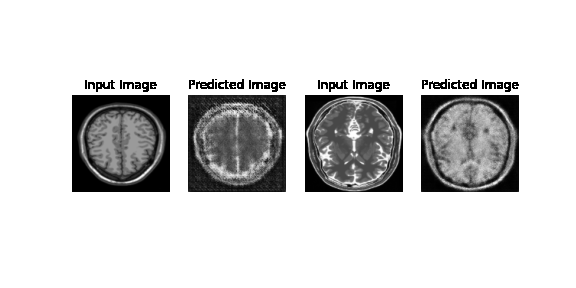

In [67]:
# Display the GIF
display(Image(filename=anim_file))

### Let's Generate T1 and T2 images

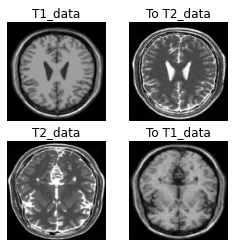

In [69]:
sample_T1_data = next(iter(Tr1_data))
sample_T2_data = next(iter(Tr2_data))

to_T2_data = generator_g(sample_T1_data)
to_T1_data = generator_f(sample_T2_data)
plt.figure(figsize=(4, 4))

imgs = [sample_T1_data, to_T2_data, sample_T2_data, to_T1_data]
title = ['T1_data', 'To T2_data', 'T2_data', 'To T1_data']

for i in range(len(imgs)):
    plt.subplot(2, 2, i+1)
    plt.title(title[i])
    plt.imshow(imgs[i][0].numpy()[:, :, 0], cmap='gray')
    plt.axis('off')
plt.show()